| Student | ID | Email |
|-----------|-----------|-----------|
| Mattia Buzzoni         | 0001145667| mattia.buzzoni@studio.unibo.it       |
| Riccardo Romeo         | 0001145681| riccardo.romeo@studio.unibo.it       |
| Mirko Mornelli         | 0001113084| mirko.mornelli@studio.unibo.it       |

# **Product Recognition of Food Products**

## Image Processing and Computer Vision - Assignment Module \#1


Contacts:

- Prof. Giuseppe Lisanti -> giuseppe.lisanti@unibo.it
- Prof. Samuele Salti -> samuele.salti@unibo.it
- Alex Costanzino -> alex.costanzino@unibo.it
- Francesco Ballerini -> francesco.ballerini4@unibo.it


Computer vision-based object detection techniques can be applied in super market settings to build a system that can identify products on store shelves.
An example of how this system could be used would be to assist visually impaired customers or automate common store management tasks like detecting low-stock or misplaced products, given an image of a shelf in a store.

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


## Task
Develop a computer vision system that, given a reference image for each product, is able to identify such product from one picture of a store shelf.

<figure>
<a href="https://imgbb.com/">
  <center>
  <img src="https://i.ibb.co/TwkMWnH/Screenshot-2024-04-04-at-14-54-51.png" alt="Screenshot-2024-04-04-at-14-54-51" border="0" width="300" />
</a>
</figure>

For each type of product displayed in the
shelf the system should report:
1. Number of instances;
1. Dimension of each instance (width and height in pixel of the bounding box that enclose them);
1. Position in the image reference system of each instance (center of the bounding box that enclose them).

#### Example of expected output
```
Product 0 - 2 instance found:
  Instance 1 {position: (256, 328), width: 57px, height: 80px}
  Instance 2 {position: (311, 328), width: 57px, height: 80px}
Product 1 – 1 instance found:
.
.
.
```

### Track A - Single Instance Detection
Develop an object detection system to identify single instance of products given one reference image for each item and a scene image.

The system should be able to correctly identify all the product in the shelves
image.

### Track B - Multiple Instances Detection
In addition to what achieved at step A, the system should also be able to detect multiple instances of the same product.

## Data
Two folders of images are provided:
* **Models**: contains one reference image for each product that the system should be able to identify.
* **Scenes**: contains different shelve pictures to test the developed algorithm in different scenarios. The images contained in this folder are corrupted by noise.

#### Track A - Single Instance Detection
* **Models**: {ref1.png to ref14.png}.
* **Scenes**: {scene1.png to scene5.png}.

#### Track B - Multiple Instances Detection
* **Models**: {ref15.png to ref27.png}.
* **Scenes**: {scene6.png to scene12.png}.

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

!cp -r /content/drive/MyDrive/AssignmentsIPCV/dataset.zip ./
!unzip dataset.zip

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Archive:  dataset.zip
replace __MACOSX/._dataset? [y]es, [n]o, [A]ll, [N]one, [r]ename: A
  inflating: __MACOSX/._dataset      
  inflating: __MACOSX/dataset/._scenes  
  inflating: dataset/.DS_Store       
  inflating: __MACOSX/dataset/._.DS_Store  
  inflating: __MACOSX/dataset/._models  
  inflating: dataset/scenes/scene12.png  
  inflating: __MACOSX/dataset/scenes/._scene12.png  
  inflating: dataset/scenes/scene10.png  
  inflating: __MACOSX/dataset/scenes/._scene10.png  
  inflating: dataset/scenes/scene11.png  
  inflating: __MACOSX/dataset/scenes/._scene11.png  
  inflating: dataset/scenes/scene5.png  
  inflating: __MACOSX/dataset/scenes/._scene5.png  
  inflating: dataset/scenes/scene4.png  
  inflating: __MACOSX/dataset/scenes/._scene4.png  
  inflating: dataset/scenes/scene6.png  
  inflating: __MACOSX/dataset/scenes/._scene6.png  
  inflating: da

## Evaluation criteria
1. **Procedural correctness**. There are several ways to solve the assignment. Design your own sound approach and justify every decision you make;

2. **Clarity and conciseness**. Present your work in a readable way: format your code and comment every important step;

3. **Correctness of results**. Try to solve as many instances as possible. You should be able to solve all the instances of the assignment, however, a thoroughly justified and sound procedure with a lower number of solved instances will be valued **more** than a poorly designed approach.

In [ ]:
# Importing libraries
import cv2
import numpy as np
from matplotlib import pyplot as plt
import os
import copy
from skimage.restoration import estimate_sigma

## Some functions for both tasks

Following we display some python functions those we are going to use both for task A and B.

In [ ]:
# Function to load and add images to a dictionary
def add_image(image_path, key, image_dict):
    image = cv2.imread(image_path)  # Load the image
    image_dict[key] = image  # Add the image to the dictionary with the specified key

In [ ]:
# We need a function in order to plot all the images inside a given dictionary

def plot_image(image_dict, title):
  num_images = len(image_dict)
  num_columns = 5
  num_rows = (num_images + num_columns - 1) // num_columns

  plt.figure(figsize=(4*num_columns, 3*num_rows))
  for i, (key, image) in enumerate(image_dict.items(), 1):
      plt.subplot(num_rows, num_columns, i)
      plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
      plt.title(key)

  plt.suptitle(title, fontsize=25, color='red', fontweight='bold')
  plt.tight_layout()
  plt.show()

In [ ]:
# Denoise an image dictionary with a given filter
def apply_filter(image_dict, path, filter_type, k_median=None, k_gaussian=None, s_gaussian=None, d_bil=None, s_color=None, s_space=None, h=None, h_color=None, t_size=None, s_size=None):
    # We create the return dictionary composed by filtered images
    filtered_dict = {}
    for key, image in image_dict.items():
            # We filter the image depending on the filter type
            if filter_type == "median":
              filtered_image = cv2.medianBlur(image,
                                              ksize=k_median)
            elif filter_type == "gaussian":
              filtered_image = cv2.GaussianBlur(image,
                                                ksize=k_gaussian,
                                                sigmaX=s_gaussian)
            elif filter_type == "bilateral":
              filtered_image = cv2.bilateralFilter(image,
                                                  d=d_bil,
                                                  sigmaColor=s_color,
                                                  sigmaSpace=s_space)
            elif filter_type == "nl_means":
              filtered_image = cv2.fastNlMeansDenoisingColored(src=image,
                                                              dst=None,
                                                              h=h,
                                                              hColor=h_color,
                                                              templateWindowSize=t_size,
                                                              searchWindowSize=s_size)
            # We add the filtered image to the return dictionary
            filtered_dict[key] = filtered_image
            # We save the filtered image
            output_path = os.path.join(f"drive/MyDrive/AssignmentsIPCV/Filter/{path}_filter", f"{key}_{path}_filtered.png")
            cv2.imwrite(output_path, filtered_image)

    # We return the dictionary of filtered images
    return filtered_dict

In [ ]:
def edge_detector(image_dict, path, minThresh, maxThresh):

    edge_dict = {}
    for key, image in image_dict.items():
        # We use canny in order to detect the image edges
        edged_image = cv2.Canny(image, minThresh, maxThresh)
        edge_dict[key] = edged_image

        # Save filtered image
        output_path = os.path.join(f"drive/MyDrive/AssignmentsIPCV/Filter/edges/{path}_filtered", f"{key}_{path}_filtered_edges.png")
        cv2.imwrite(output_path, edged_image)

    return edge_dict

In [ ]:
# This function computes the mean estimated sigma on all the images inside a dictionary
def compute_mean_sigma_noise(image_dict):

      estimated_sigmas = []
      #for each given image we compute its estimated sigma noise
      for key, image in image_dict.items():
          image_gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
          sigma = estimate_sigma(image_gray, channel_axis=None)
          estimated_sigmas.append(sigma)

      # We compute the mean sigma noise
      mean_sigma = sum(estimated_sigmas) / len(estimated_sigmas)
      return mean_sigma

In [ ]:
# this simple function is used in order to compute the keypoints with SIFT of the images in a dictionary
def keypoints_detector(image_dict):
    keypoints_dict = {}
    for key, image in image_dict.items():
        # Initiate SIFT detector
        sift = cv2.xfeatures2d.SIFT_create()
        # find the keypoints and descriptors with SIFT
        kp_query = sift.detect(image)
        # Use flag DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS to show scale and orientation of keypoints.
        keypoint_image = cv2.drawKeypoints(image, kp_query, None, flags = cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

        keypoints_dict[key] = keypoint_image

        # Save filtered image
        output_path = os.path.join("drive/MyDrive/AssignmentsIPCV/Filter/keypoints", f"{key}_keypoints.png")
        cv2.imwrite(output_path, keypoint_image)

    return keypoints_dict

# Solution track A - Single Instance Detection

First of all we need to understand what type of images are inside the given dataset. In order to do that we decided to plot all the scenes and the models, creating two python dictionaries

In [ ]:
##### Here we create two dictionaries: one containing all the given models and one for the scenes #####

# Initialize an empty dictionary to store model images
model_dict = {}
# Initialize an empty dictionary to store scene images
scene_dict = {}

# Now we store all the model images inside the model dictionary
for i in range(1, 15):
    image_path = f"dataset/models/ref{i}.png"
    key = f"ref{i}"
    add_image(image_path, key, model_dict)

# Now we store all the model images inside the scene dictionary
for i in range(1, 6):
    image_path = f"dataset/scenes/scene{i}.png"
    key = f"scene{i}"
    add_image(image_path, key, scene_dict)

Following we display the plots of all scenes:

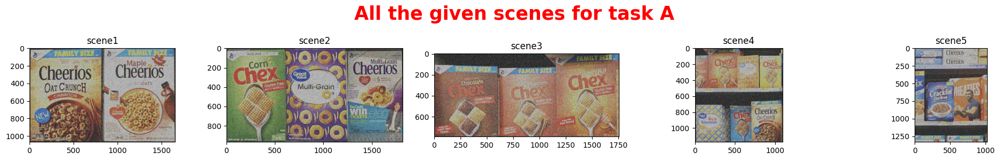

In [ ]:
plot_image(scene_dict, 'All the given scenes for task A')

Now, it is clearly visible that all the given scenes are partially corrupted by some noise.
First of all, we need to clean the scenes by that noise.
We assume that in the scenes has been introduced some kind of gaussian noise, this is clearly visible in some parts of these scenes.

At this point the main problem is to find a way in order to clean these images by noise without introduce too much distorsion. In order to understand what kind of filter we should use, we decided to apply the Canny edge detection after every filtering step.

We think that the results of edge detection could be a good indicator in order to understand if the applied filter is too "aggressive".

Also, we decided to compute each time the estimated sigma of the gaussian noise inside the image. In order to do this we used the function "estimate_sigma" of "skimage.restoration". Obviously, this value is only an estimation, but it could be significant jointly the edges, in order to understand what filtering process we should perform.

A third idea in order to evaluate the noise inside an image is the following: we take a part of one scene that should be flat and uniform for the intensity color. For example: in the scene 4 there is an area in the middle of the image that should be almost entirely black.
Then, taken this part, we could compute its histogram. The idea is that, if the image is noisy, then, its histogram will appear "wavy", non-uniform and non-Gaussian. On the other hand, a well denoised image should present a "Gaussian-like histogram".

In [ ]:
MSN_not_filtered = compute_mean_sigma_noise(scene_dict)
print(f"The mean estimated sigma of the gaussian noise in the given scenes is: {MSN_not_filtered:.2f}")

The mean estimated sigma of the gaussian noise in the given scenes is: 51.49


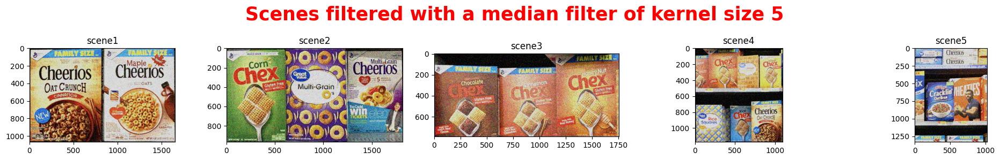

In [ ]:
path = 'median'
kernel_size = 5
filtered_scene_dict_median = apply_filter(image_dict=scene_dict,
                                          path=path,
                                          filter_type='median',
                                          k_median=kernel_size)
plot_image(filtered_scene_dict_median, f"Scenes filtered with a median filter of kernel size {kernel_size}")

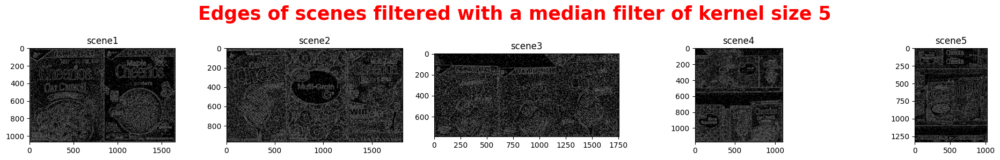

In [ ]:
filtered_scene_dict_median_edges = edge_detector(filtered_scene_dict_median, path, minThresh=250, maxThresh=300)
plot_image(filtered_scene_dict_median_edges, f"Edges of scenes filtered with a median filter of kernel size {kernel_size}")

In [ ]:
MSN_median_filtered = compute_mean_sigma_noise(filtered_scene_dict_median)
print(f"The mean estimated sigma of the gaussian noise in the scenes filtered with a median filter is: {MSN_median_filtered:.2f}")

The mean estimated sigma of the gaussian noise in the scenes filtered with a median filter is: 3.70


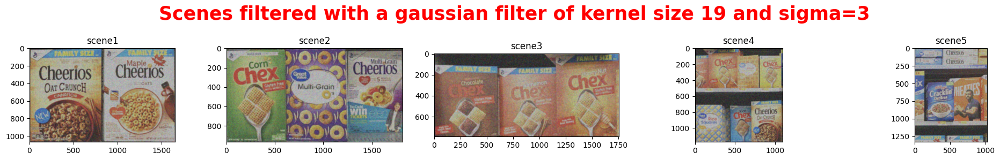

In [ ]:
path = 'gaussian'
kernel_gaussian = (19,19)
sigma_gaussian = 3
filtered_scene_dict_gaus = apply_filter(image_dict=scene_dict,
                                        path=path,
                                        filter_type='gaussian',
                                        k_gaussian=kernel_gaussian,
                                        s_gaussian=sigma_gaussian)
plot_image(filtered_scene_dict_gaus, f"Scenes filtered with a gaussian filter of kernel size {kernel_gaussian[0]} and sigma={sigma_gaussian}")

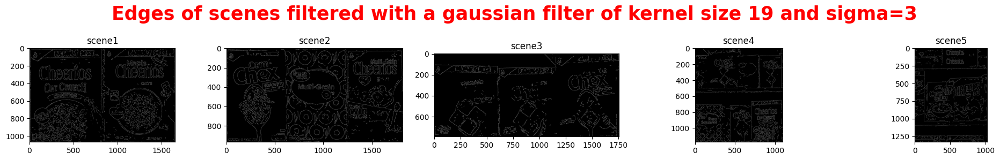

In [ ]:
filtered_scene_dict_gaus_edges = edge_detector(filtered_scene_dict_gaus, path, minThresh=50, maxThresh=90)
plot_image(filtered_scene_dict_gaus_edges, f"Edges of scenes filtered with a gaussian filter of kernel size {kernel_gaussian[0]} and sigma={sigma_gaussian}")

In [ ]:
MSN_gaussian_filtered = compute_mean_sigma_noise(filtered_scene_dict_gaus)
print(f"The mean estimated sigma of the gaussian noise in the scenes filtered with a gaussian filter is: {MSN_gaussian_filtered:.2f}")

The mean estimated sigma of the gaussian noise in the scenes filtered with a gaussian filter is: 0.35


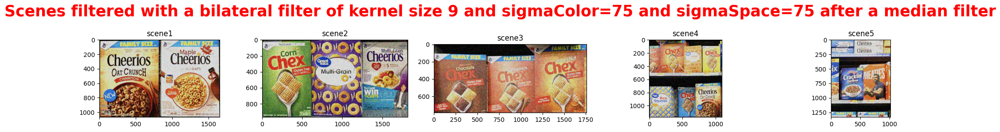

In [ ]:
path = 'median_bilateral'
d_bilateral = 9
sigma_color = 75
sigma_space = 75
filtered_scene_dict_median_bil = apply_filter(image_dict=filtered_scene_dict_median,
                                        path=path,
                                        filter_type='bilateral',
                                        d_bil=d_bilateral,
                                        s_color=sigma_color,
                                        s_space=sigma_space)
plot_image(filtered_scene_dict_median_bil, f"Scenes filtered with a bilateral filter of kernel size {d_bilateral} and sigmaColor={sigma_color} and sigmaSpace={sigma_space} after a median filter")

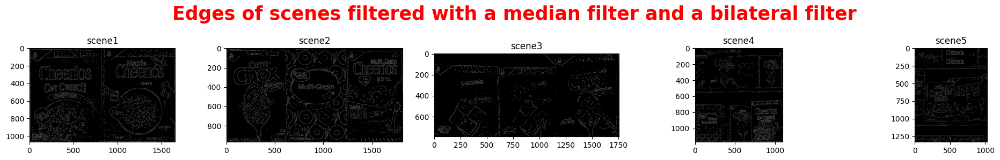

In [ ]:
filtered_scene_dict_median_bil_edges = edge_detector(filtered_scene_dict_median_bil, path, minThresh=250, maxThresh=300)
plot_image(filtered_scene_dict_median_bil_edges, f"Edges of scenes filtered with a median filter and a bilateral filter")

In [ ]:
MSN_median_bil_filtered = compute_mean_sigma_noise(filtered_scene_dict_median_bil)
print(f"The mean estimated sigma of the gaussian noise in the scenes filtered with a median filter and a bilateral one is: {MSN_median_bil_filtered:.2f}")

The mean estimated sigma of the gaussian noise in the scenes filtered with a median filter and a bilateral one is: 0.86


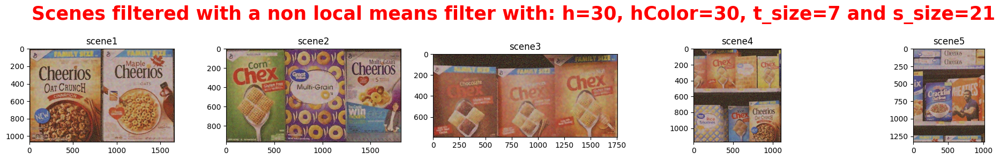

In [ ]:
path = 'nl_means'
h_nlmeans = 30
hColor_nlmeans = 30
t_size = 7
s_size = 21
filtered_scene_dict_nl_means = apply_filter(image_dict=scene_dict,
                                        path=path,
                                        filter_type='nl_means',
                                        h=h_nlmeans,
                                        h_color=hColor_nlmeans,
                                        t_size=t_size,
                                        s_size=s_size)
plot_image(filtered_scene_dict_nl_means, f"Scenes filtered with a non local means filter with: h={h_nlmeans}, hColor={hColor_nlmeans}, t_size={t_size} and s_size={s_size}")

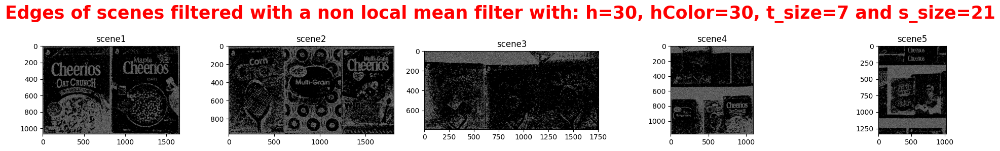

In [ ]:
filtered_scene_dict_nl_means_edges = edge_detector(filtered_scene_dict_nl_means, path, minThresh=250, maxThresh=300)
plot_image(filtered_scene_dict_nl_means_edges, f"Edges of scenes filtered with a non local mean filter with: h={h_nlmeans}, hColor={hColor_nlmeans}, t_size={t_size} and s_size={s_size}")

In [ ]:
MSN_nl_means_filtered = compute_mean_sigma_noise(filtered_scene_dict_nl_means)
print(f"The mean estimated sigma of the gaussian noise in the scenes filtered with a Non local mean filter is: {MSN_nl_means_filtered:.2f}")

The mean estimated sigma of the gaussian noise in the scenes filtered with a Non local mean filter is: 14.49


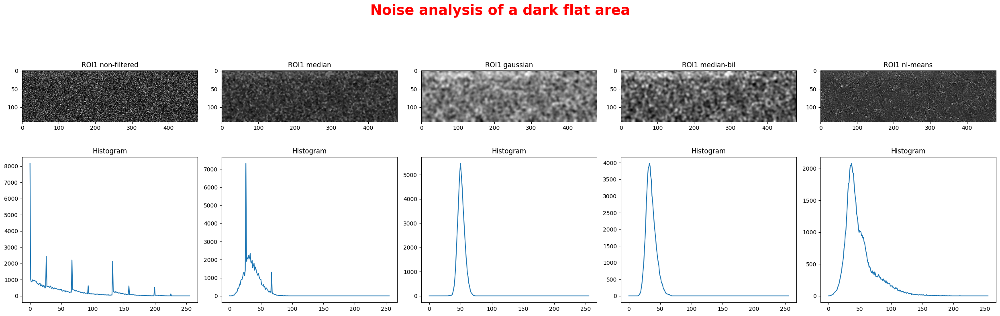

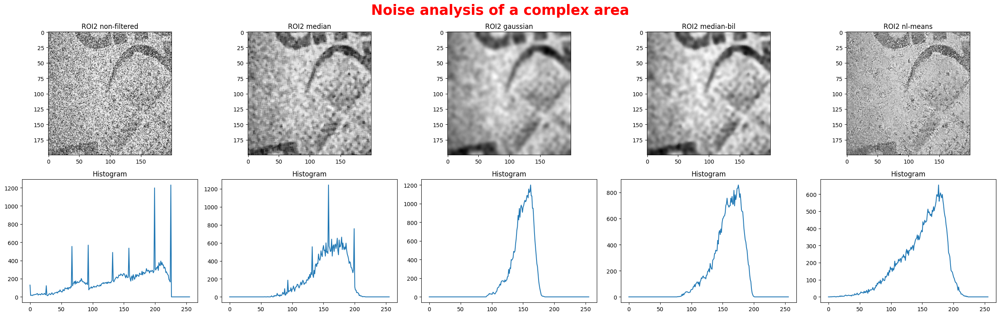

In [ ]:
# Form the scene 4 we take 2 area of interest, the first one should be black, the second one is more "complex"
scene4 = scene_dict['scene4']
y = 560
x = 200
h = 140
w = 480
ROI1_scene4 = scene4[y:y+h, x:x+w]
ROI1_scene4_gray = cv2.cvtColor(ROI1_scene4, cv2.COLOR_BGR2GRAY)

y1 = 200
x1 = 200
h1 = 200
w1 = 200
ROI2_scene4 = scene4[y1:y1+h1, x1:x1+w1]
ROI2_scene4_gray = cv2.cvtColor(ROI2_scene4, cv2.COLOR_BGR2GRAY)

ROI1 = {}
hist = cv2.calcHist([ROI1_scene4_gray], [0], None, [256], [0, 256])
ROI1[("ROI1","non-filtered")] = (ROI1_scene4_gray, hist)
# We filter the ROI1 with all the filtering process we made above
ROI1_scene4_median_filtered_gray = cv2.medianBlur(ROI1_scene4_gray, 5)
hist = cv2.calcHist([ROI1_scene4_median_filtered_gray], [0], None, [256], [0, 256])
ROI1[("ROI1","median")] = (ROI1_scene4_median_filtered_gray, hist)
ROI1_scene4_gaussian_filtered_gray = cv2.GaussianBlur(ROI1_scene4_gray, ksize=(19,19), sigmaX=3)
hist = cv2.calcHist([ROI1_scene4_gaussian_filtered_gray], [0], None, [256], [0, 256])
ROI1[("ROI1","gaussian")] = (ROI1_scene4_gaussian_filtered_gray, hist)
ROI1_scene4_median_bil_filtered_gray = cv2.bilateralFilter(ROI1_scene4_median_filtered_gray, d=9, sigmaColor=75, sigmaSpace=75)
hist = cv2.calcHist([ROI1_scene4_median_bil_filtered_gray], [0], None, [256], [0, 256])
ROI1[("ROI1","median-bil")] = (ROI1_scene4_median_bil_filtered_gray, hist)
ROI1_scene4_fastNl_filtered_gray = cv2.fastNlMeansDenoising(ROI1_scene4_gray,None,30,7,21)
hist = cv2.calcHist([ROI1_scene4_fastNl_filtered_gray], [0], None, [256], [0, 256])
ROI1[("ROI1","nl-means")] = (ROI1_scene4_fastNl_filtered_gray, hist)

ROI2 = {}
hist = cv2.calcHist([ROI2_scene4_gray], [0], None, [256], [0, 256])
ROI2[("ROI2","non-filtered")] = (ROI2_scene4_gray, hist)
# We filter the ROI2 with all the filtering process we made above
ROI2_scene4_median_filtered_gray = cv2.medianBlur(ROI2_scene4_gray, 5)
hist = cv2.calcHist([ROI2_scene4_median_filtered_gray], [0], None, [256], [0, 256])
ROI2[("ROI2","median")] = (ROI2_scene4_median_filtered_gray, hist)
ROI2_scene4_gaussian_filtered_gray = cv2.GaussianBlur(ROI2_scene4_gray, ksize=(19,19), sigmaX=3)
hist = cv2.calcHist([ROI2_scene4_gaussian_filtered_gray], [0], None, [256], [0, 256])
ROI2[("ROI2","gaussian")] = (ROI2_scene4_gaussian_filtered_gray, hist)
ROI2_scene4_median_bil_filtered_gray = cv2.bilateralFilter(ROI2_scene4_median_filtered_gray, d=9, sigmaColor=75, sigmaSpace=75)
hist = cv2.calcHist([ROI2_scene4_median_bil_filtered_gray], [0], None, [256], [0, 256])
ROI2[("ROI2","median-bil")] = (ROI2_scene4_median_bil_filtered_gray, hist)
ROI2_scene4_fastNl_filtered_gray = cv2.fastNlMeansDenoising(ROI2_scene4_gray,None,30,7,21)
hist = cv2.calcHist([ROI2_scene4_fastNl_filtered_gray], [0], None, [256], [0, 256])
ROI2[("ROI2","nl-means")] = (ROI2_scene4_fastNl_filtered_gray, hist)



def plot_ROI(image_dict, title):
    num_images = len(image_dict)
    num_columns = 5
    num_rows = (num_images + num_columns - 1) // num_columns

    plt.figure(figsize=(5*num_columns, 8*num_rows))
    for i, (key, value) in enumerate(image_dict.items(), 1):
        image = image_dict[key][0]
        hist = image_dict[key][1]

        # Plotting the image in gray scale
        plt.subplot(num_rows*2, num_columns, i)
        plt.imshow(image, cmap='gray')
        plt.title(f"{key[0]} {key[1]}")
        # plotting the histogram
        plt.subplot(num_rows*2, num_columns, i + num_columns)
        plt.plot(hist)
        plt.title('Histogram')

    #plt.suptitle(title, fontsize=25, color='red', fontweight='bold')
    plt.suptitle(title, fontsize=25, color='red', fontweight='bold')
    plt.tight_layout()
    plt.show()

plot_ROI(ROI1, "Noise analysis of a dark flat area")
plot_ROI(ROI2, "Noise analysis of a complex area")

Observing the results above we decided to perform a combination between a median filter and a bilateral one.
The idea is that, the median filter should be able to erase an eventual salt-and-pepper noise, while the bilateral should erase the gaussian one. In order to don't smooth too much the image, we decided to apply the median filter before the bilateral.

Another valid alternative, would be to use the non local means filter, which presents good performances in terms of edge detection and noise erasing. Furthermore, a non local mean filter is also able to preserve better the edges of the image. This is visible in the images reported above.
On the other hand, the non local means filter takes more computational time than the application of the median and bilateral filters.

At the end, we decided to opt for the combination of median and bilateral filter. In fact, we think that this should permit to us to erase enough noise, without taking too much time for the filtering process.

At this point, we decided also to plot the keypoints found by SIFT, for each model and also for each filtered scene.

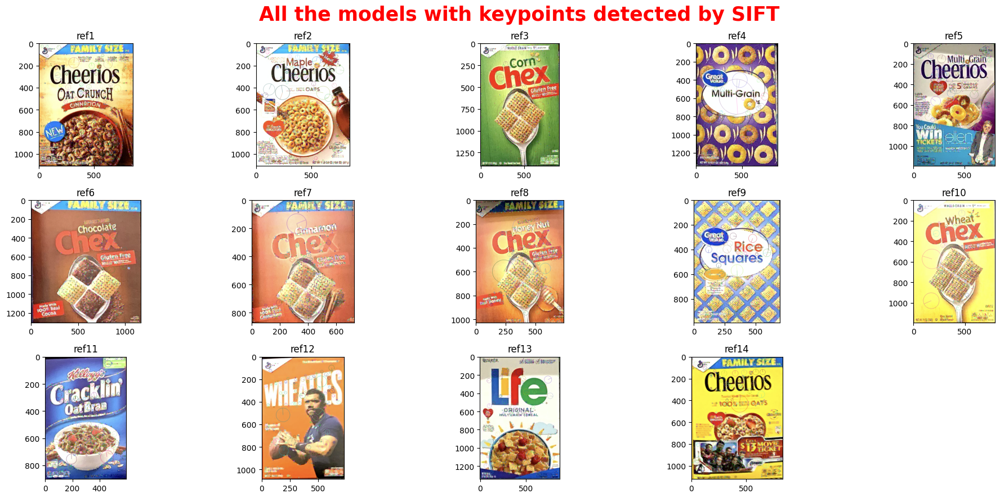

In [ ]:
keypoints_models_dict = keypoints_detector(model_dict)

plot_image(keypoints_models_dict, 'All the models with keypoints detected by SIFT')

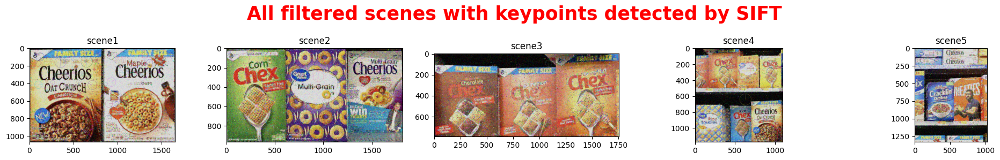

In [ ]:
keypoints_scenes_dict = keypoints_detector(filtered_scene_dict_median_bil)

plot_image(keypoints_scenes_dict, 'All filtered scenes with keypoints detected by SIFT')

It's clearly visible that there is a little mismatch between the keypoints found on the model and those found in the filtered scenes.

But, at this point we decided to try to perform a detection with this input images in order to evaluate the performances.

In order to perform an object detection we need a function able to find an image inside another image. We make this with the following "object_retrive" function.
At each call, we will also pass the minimum number of matches (min_match_count) we want to use in order to have "sure" detection.

In [ ]:
# Define a function for object detection pipeline
def object_retrieve(img_query, img_train, min_match_count):

    sift = cv2.xfeatures2d.SIFT_create()
    kp_query = sift.detect(img_query)
    kp_train = sift.detect(img_train)
    kp_query, des_query = sift.compute(img_query, kp_query)
    kp_train, des_train = sift.compute(img_train, kp_train)

    FLANN_INDEX_KDTREE = 1
    index_params = dict(algorithm = FLANN_INDEX_KDTREE, trees = 5)
    search_params = dict(checks = 60)

    flann = cv2.FlannBasedMatcher(index_params, search_params)
    matches = flann.knnMatch(des_query,des_train,k=2)

    # We select good matches
    good = []
    for m,n in matches:
        if m.distance < 0.7*n.distance:
            good.append(m)

    returns = {}
    returns.clear()

    if len(good) > min_match_count:
      # building the corrspondences arrays of good matches
      src_pts = np.float32([ kp_query[m.queryIdx].pt for m in good ]).reshape(-1,1,2)
      dst_pts = np.float32([ kp_train[m.trainIdx].pt for m in good ]).reshape(-1,1,2)
      # Using RANSAC to estimate a robust homography.
      # It returns the homography M and a mask for the discarded points
      M, mask = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 5.0)

      # Mask of discarded point used in visualization
      matchesMask = mask.ravel().tolist()

      # Corners of the query image
      h,w,c = img_query.shape
      pts = np.float32([ [0,0],[0,h-1],[w-1,h-1],[w-1,0] ]).reshape(-1,1,2)

      # Projecting the corners into the train image
      dst = cv2.perspectiveTransform(pts,M)

      # Drawing the bounding box
      img_train_p = cv2.polylines(img_train,[np.int32(dst)],True,(0,0,255),10, cv2.LINE_AA)

      returns.update({1: img_train_p})

    return returns

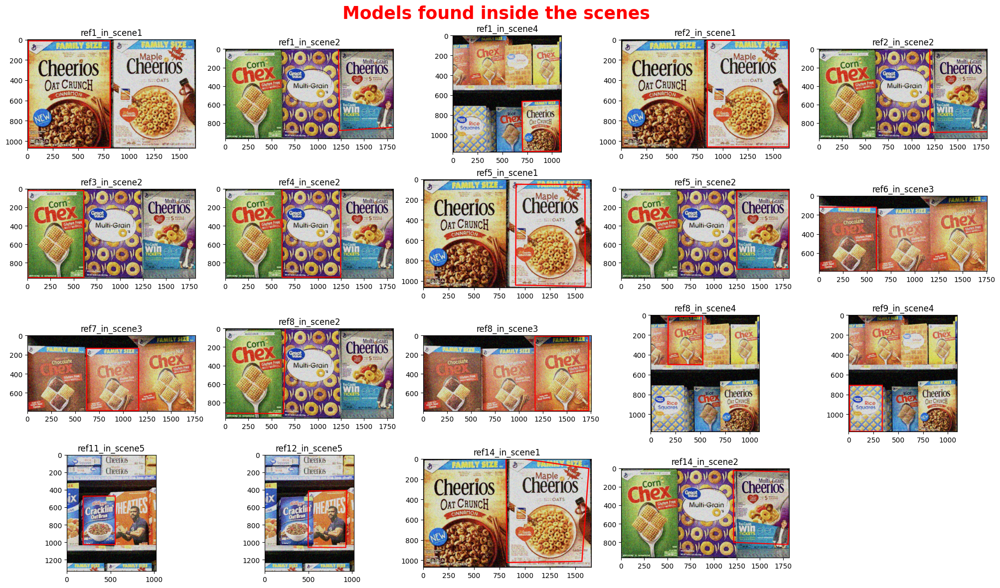

In [ ]:
found_image_scene_dict = {}

for model_key, model_image in model_dict.items():
  filtered_scene_dict_mean_bil_copy = copy.deepcopy(filtered_scene_dict_median_bil)

  for scene_key, scene_image in filtered_scene_dict_mean_bil_copy.items():

    found = object_retrieve(model_image, scene_image, 60)
    if len(found) != 0:
      found_key = f"{model_key}_in_{scene_key}"
      found_image_scene_dict[found_key] = found[1]

plot_image(found_image_scene_dict, "Models found inside the scenes")

As we can see, the problem is that decreasing the minimum number of matches, the algorithm tends to find a model in a scene where another similar box is present. On the other hand, encreasing this parameter, we only find a bounch of boxes.

We tried several values of "min_match_count", we don't report here the results, but the behaviour is the same descripted above.

At this point, it could be a good idea to check the behaviour with another filter. In particular, we decided to apply the non local means filter because of its advantages.

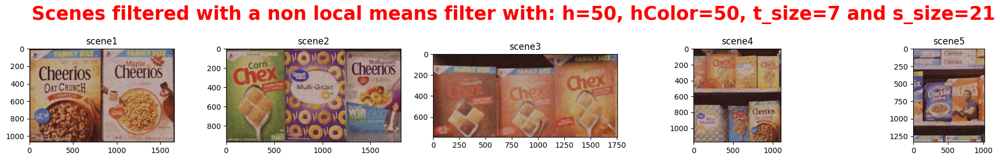

In [ ]:
# Denoise with fast NI Means filter
path = 'nl_means'
h_nlmeans = 50
hColor_nlmeans = 50
t_size = 7
s_size = 21
filtered_scene_dict_nl_means = apply_filter(image_dict=scene_dict,
                                        path=path,
                                        filter_type='nl_means',
                                        h=h_nlmeans,
                                        h_color=hColor_nlmeans,
                                        t_size=t_size,
                                        s_size=s_size)
plot_image(filtered_scene_dict_nl_means, f"Scenes filtered with a non local means filter with: h={h_nlmeans}, hColor={hColor_nlmeans}, t_size={t_size} and s_size={s_size}")

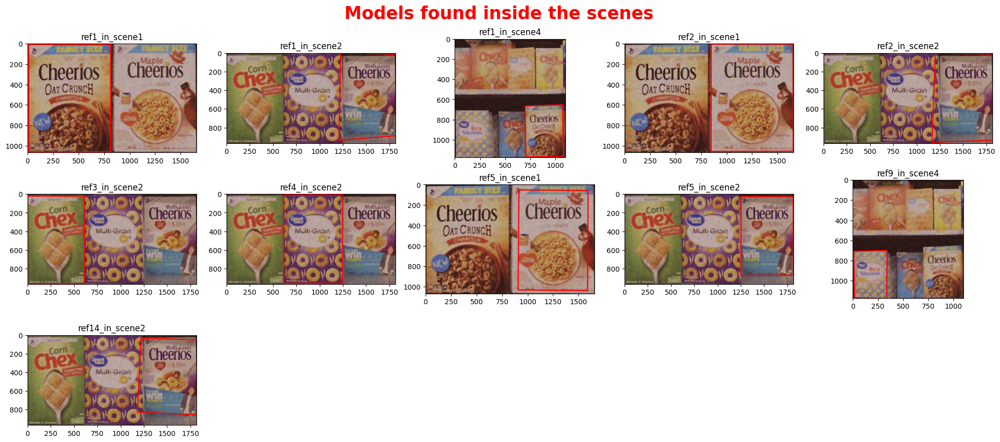

In [ ]:
found_image_scene_dict = {}

for model_key, model_image in model_dict.items():
  filtered_scene_dict_nl_means_copy = copy.deepcopy(filtered_scene_dict_nl_means)

  for scene_key, scene_image in filtered_scene_dict_nl_means_copy.items():

    found = object_retrieve(model_image, scene_image, 60)
    if len(found) != 0:
      found_key = f"{model_key}_in_{scene_key}"
      found_image_scene_dict[found_key] = found[1]

plot_image(found_image_scene_dict, "Models found inside the scenes")

The performances are the same for both median-bilateral filtered scenes and the case of non local means filtered scenes.

Now, due to the results we found above, it could be a a good idea to change the function "object_retrieve" in order to perform a better object detection.

In particular we decided to compute a "confidence" parameter. This value is obtained by the ratio between the number of inliers and the total number of matches (inliers + outliers).

We are going to use this parameter in order to evaluate how much an object detection is "sure".

At the end of the following code-block, we make a dictionary with all the found boxes in the scenes with the corresponding confidence.

In [ ]:
def object_retrieve(img_query, img_train, min_match_count):
    sift = cv2.xfeatures2d.SIFT_create()
    kp_query, des_query = sift.detectAndCompute(img_query, None)
    kp_train, des_train = sift.detectAndCompute(img_train, None)

    FLANN_INDEX_KDTREE = 1
    index_params = dict(algorithm=FLANN_INDEX_KDTREE, trees=5)
    search_params = dict(checks=70)

    flann = cv2.FlannBasedMatcher(index_params, search_params)
    matches = flann.knnMatch(des_query, des_train, k=2)

    good_matches = []
    for m, n in matches:
        if m.distance < 0.7 * n.distance:
            good_matches.append(m)

    returns = []

    if len(good_matches) > min_match_count:
        src_pts = np.float32([kp_query[m.queryIdx].pt for m in good_matches]).reshape(-1, 1, 2)
        dst_pts = np.float32([kp_train[m.trainIdx].pt for m in good_matches]).reshape(-1, 1, 2)

        # Estimate perspective transformation using RANSAC
        M, mask = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 5.0)
        matchesMask = mask.ravel().tolist()

        # Calculate the confidence based on the number of inliers
        confidence = sum(matchesMask) / len(matchesMask)
        # if the confidence is enough, we consider the box as found
        if confidence > 0.4:
            h, w = img_query.shape[:2]
            pts = np.float32([[0, 0], [0, h - 1], [w - 1, h - 1], [w - 1, 0]]).reshape(-1, 1, 2)
            dst = cv2.perspectiveTransform(pts, M)
            center_x = (dst[0][0][0] + dst[2][0][0]) / 2
            center_y = (dst[0][0][1] + dst[2][0][1]) / 2

            returns.append((confidence, (center_x, center_y), img_train, dst))

    return returns


found_image_scene_dict = {}
for model_key, model_image in model_dict.items():
    filtered_scene_dict_median_bil_copy = copy.deepcopy(filtered_scene_dict_median_bil)

    for scene_key, scene_image in filtered_scene_dict_median_bil_copy.items():
          found = object_retrieve(model_image, scene_image, 30)
          if found:
            confidence, center, image, dst = found[0]
            found_image_scene_dict[(model_key, scene_key)] = (center, image, confidence, dst)


Now, we know that in one position there could exist only one object. So, we check all the found objects with the same center and we select the one with the highest confidence.

Note that, it is improbable that two found objects have the same center, so, we are going to consider two objects in the same position if their centers are close enough.

In [ ]:
scenes = ['scene1', 'scene2', 'scene3', 'scene4', 'scene5']
returns = {}
for scene in scenes:
    selected_items = {}
    for key, value in found_image_scene_dict.items():
      if key[1] == scene:
        selected_items.update({key: value})

    selected_items_copy = copy.deepcopy(selected_items)

    # per ogni ref in quella scena
    for key, value in selected_items.items():
        # controllo se ha lo stesso centro di un altro ref in quella scena
          for key1, value1 in selected_items.items():
            if key != key1:
              distance = np.linalg.norm(np.array(selected_items[key][0]) - np.array(selected_items[key1][0]))
              # se ce l'hanno elimino dal dizionario quello con la confidence più bassa
              if(distance < 150):
                  if(selected_items[key][2] > selected_items[key1][2]):
                    if key1 in selected_items_copy:
                        v = selected_items_copy.pop(key1)
                  elif(selected_items[key][2] <= selected_items[key1][2]):
                    if key in selected_items_copy:
                        v = selected_items_copy.pop(key)

    print(f"\nAll the models found withe the best confidence in {scene}:")
    for key, value in selected_items_copy.items():
      print(f"{key} with confidence: {value[2]:.2f} at position: {value[0]}")

    returns.update(selected_items_copy)


All the models found withe the best confidence in scene1:
('ref1', 'scene1') with confidence: 0.92 at position: (412.083984375, 539.0079956054688)
('ref2', 'scene1') with confidence: 0.85 at position: (1247.38671875, 533.07958984375)

All the models found withe the best confidence in scene2:
('ref3', 'scene2') with confidence: 0.77 at position: (305.57464599609375, 493.4425048828125)
('ref4', 'scene2') with confidence: 0.73 at position: (928.0830078125, 484.5351867675781)
('ref5', 'scene2') with confidence: 0.87 at position: (1528.2198486328125, 449.94940185546875)

All the models found withe the best confidence in scene3:
('ref6', 'scene3') with confidence: 0.66 at position: (298.9340515136719, 458.5614013671875)
('ref7', 'scene3') with confidence: 0.68 at position: (889.2159423828125, 460.8065185546875)
('ref8', 'scene3') with confidence: 0.80 at position: (1446.90966796875, 398.56695556640625)

All the models found withe the best confidence in scene4:
('ref1', 'scene4') with confid

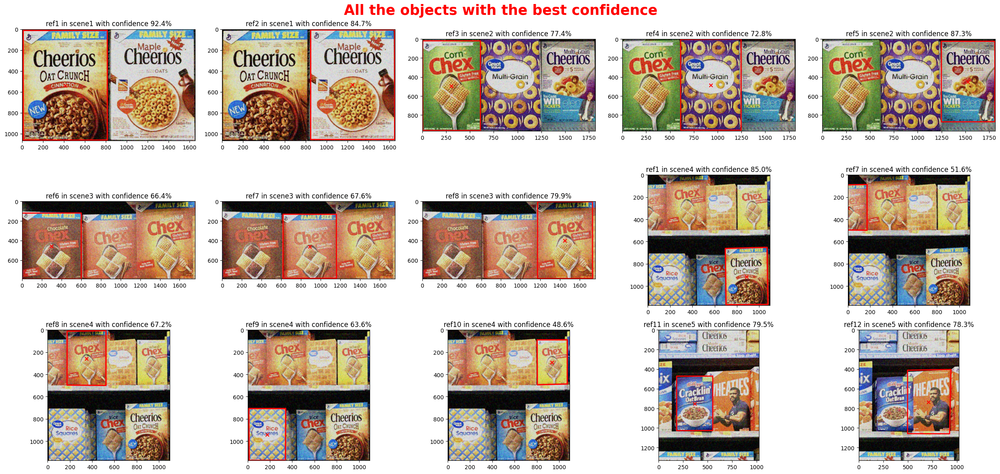

In [ ]:
# The following function is used in order to plot the results obtained above
def plot_dict(image_dict, title):
  num_images = len(image_dict)
  num_columns = 5
  num_rows = (num_images + num_columns - 1) // num_columns

  plt.figure(figsize=(5*num_columns, 4*num_rows))
  for i, (key, value) in enumerate(image_dict.items(), 1):
      center = image_dict[key][0]
      image = image_dict[key][1]
      confidence = round(image_dict[key][2], 3) * 100
      dst = image_dict[key][3]

      # drawing the bounding box
      image_with_box = cv2.polylines(image, [np.int32(dst)], True, (0, 0, 255), 10, cv2.LINE_AA)

      if image.shape[-1] == 3:  # If image is in BGR format
            image_with_box = cv2.cvtColor(image_with_box, cv2.COLOR_BGR2RGB)

      plt.subplot(num_rows, num_columns, i)
      plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
      # plotting the center of the image
      plt.scatter(center[0], center[1], c='r', marker='x')
      plt.title(f"{key[0]} in {key[1]} with confidence {confidence:.1f}%")

  plt.suptitle(title, fontsize=25, color='red', fontweight='bold')
  plt.tight_layout()
  plt.show()

plot_dict(returns, 'All the objects with the best confidence')

In [ ]:
# We print the obtained results
scenes = ['scene1', 'scene2', 'scene3', 'scene4', 'scene5']
for scene in scenes:
  print(f"In {scene} we found: ")
  for key, value in returns.items():
      if key[1] == scene:
        h = np.linalg.norm(np.array(value[3][0][0]) - np.array(value[3][1][0]))
        w = np.linalg.norm(np.array(value[3][1][0]) - np.array(value[3][2][0]))
        print(f"\tProduct {key[0]} - 1 instance found:")
        print(f"\t\tInstance 1 {{({value[0][0]:.0f},{value[0][1]:.0f}), width: {w:.0f}px, height: {h:.0f}px}}")
  print("\n")

In scene1 we found: 
	Product ref1 - 1 instance found:
		Instance 1 {(412,539), width: 802px, height: 1049px}
	Product ref2 - 1 instance found:
		Instance 1 {(1247,533), width: 802px, height: 1048px}


In scene2 we found: 
	Product ref3 - 1 instance found:
		Instance 1 {(306,493), width: 604px, height: 939px}
	Product ref4 - 1 instance found:
		Instance 1 {(928,485), width: 633px, height: 949px}
	Product ref5 - 1 instance found:
		Instance 1 {(1528,450), width: 560px, height: 844px}


In scene3 we found: 
	Product ref6 - 1 instance found:
		Instance 1 {(299,459), width: 600px, height: 669px}
	Product ref7 - 1 instance found:
		Instance 1 {(889,461), width: 543px, height: 651px}
	Product ref8 - 1 instance found:
		Instance 1 {(1447,399), width: 558px, height: 779px}


In scene4 we found: 
	Product ref1 - 1 instance found:
		Instance 1 {(888,915), width: 376px, height: 505px}
	Product ref7 - 1 instance found:
		Instance 1 {(2,299), width: 340px, height: 400px}
	Product ref8 - 1 instance 

# Solution track B - Multiple Instance Detection

First of all we need to create our scene and model dictionaries.

In [ ]:
# Initialize an empty dictionary to store model images
model_dict_taskB = {}
# Initialize an empty dictionary to store scene images
scene_dict_taskB = {}

# Now we store all the model images inside the model dictionary
for i in range(15, 28):
    image_path = f"dataset/models/ref{i}.png"
    key = f"ref{i}"
    add_image(image_path, key, model_dict_taskB)

# Now we store all the model images inside the scene dictionary
for i in range(6, 13):
    image_path = f"dataset/scenes/scene{i}.png"
    key = f"scene{i}"
    add_image(image_path, key, scene_dict_taskB)

In [ ]:
keypoints_models_dict_taskB = keypoints_detector(model_dict_taskB)

# plot_image(keypoints_models_dict_taskB, 'All the models with keypoints detected by SIFT')

In [ ]:
# plot_image(scene_dict_taskB, "All the given scenes for task B")

We don't show in this section the scenes and the models in order to decrease the dimensions of this notebook.

Likely in task A, we have to deal with scenes with a great amount of noise. So, we need to try to perform several filters.

In [ ]:
MSN_not_filtered = compute_mean_sigma_noise(scene_dict_taskB)
print(f"The mean estimated sigma of the gaussian noise in the given scenes is: {MSN_not_filtered:.2f}")

The mean estimated sigma of the gaussian noise in the given scenes is: 52.11


In [ ]:
path = 'median'
kernel_size = 3
filtered_scene_dict_median_taskB = apply_filter(image_dict=scene_dict_taskB,
                                          path=path,
                                          filter_type='median',
                                          k_median=kernel_size)
# plot_image(filtered_scene_dict_median_taskB, f"Scenes filtered with a median filter of kernel size {kernel_size}")

In [ ]:
filtered_scene_dict_median_edges_taskB = edge_detector(filtered_scene_dict_median_taskB, path, minThresh=550, maxThresh=600)
# plot_image(filtered_scene_dict_median_edges_taskB, f"Edges of scenes filtered with a median filter of kernel size {kernel_size}")

In [ ]:
MSN_median_filtered = compute_mean_sigma_noise(filtered_scene_dict_median_taskB)
print(f"The mean estimated sigma of the gaussian noise in the scenes filtered with a median filter is: {MSN_median_filtered:.2f}")

The mean estimated sigma of the gaussian noise in the scenes filtered with a median filter is: 9.40


In [ ]:
path = 'median_bilateral'
d_bilateral = 13
sigma_color = 300
sigma_space = 300
filtered_scene_dict_median_bil_taskB = apply_filter(image_dict=filtered_scene_dict_median_taskB,
                                        path=path,
                                        filter_type='bilateral',
                                        d_bil=d_bilateral,
                                        s_color=sigma_color,
                                        s_space=sigma_space)
# plot_image(filtered_scene_dict_median_bil_taskB, f"Scenes filtered with a bilateral filter of kernel size {d_bilateral} and sigmaColor={sigma_color} and sigmaSpace={sigma_space} after a median filter")

In [ ]:
filtered_scene_dict_median_bil_edges_taskB = edge_detector(filtered_scene_dict_median_bil_taskB, path, minThresh=60, maxThresh=100)
# plot_image(filtered_scene_dict_median_bil_edges_taskB, f"Edges of scenes filtered with a median filter and a bilateral filter")

In [ ]:
MSN_median_bil_filtered = compute_mean_sigma_noise(filtered_scene_dict_median_bil_taskB)
print(f"The mean estimated sigma of the gaussian noise in the scenes filtered with a median filter and a bilateral one is: {MSN_median_bil_filtered:.2f}")

The mean estimated sigma of the gaussian noise in the scenes filtered with a median filter and a bilateral one is: 0.65


In [ ]:
path = 'gaussian'
kernel_gaussian = (19,19)
sigma_gaussian = 3
filtered_scene_dict_gaus_taskB = apply_filter(image_dict=scene_dict_taskB,
                                        path=path,
                                        filter_type='gaussian',
                                        k_gaussian=kernel_gaussian,
                                        s_gaussian=sigma_gaussian)
# plot_image(filtered_scene_dict_gaus_taskB, f"Scenes filtered with a gaussian filter of kernel size {kernel_gaussian[0]} and sigma={sigma_gaussian}")

In [ ]:
filtered_scene_dict_gaus_edges_taskB = edge_detector(filtered_scene_dict_gaus_taskB, path, minThresh=50, maxThresh=90)
# plot_image(filtered_scene_dict_gaus_edges_taskB, f"Edges of scenes filtered with a gaussian filter of kernel size {kernel_gaussian[0]} and sigma={sigma_gaussian}")

In [ ]:
MSN_gaussian_filtered = compute_mean_sigma_noise(filtered_scene_dict_gaus_taskB)
print(f"The mean estimated sigma of the gaussian noise in the scenes filtered with a gaussian filter is: {MSN_gaussian_filtered:.2f}")

The mean estimated sigma of the gaussian noise in the scenes filtered with a gaussian filter is: 0.35


In [ ]:
path = 'nl_means'
h_nlmeans = 60
hColor_nlmeans = 30
t_size = 7
s_size = 21
filtered_scene_dict_nl_means_taskB = apply_filter(image_dict=scene_dict_taskB,
                                        path=path,
                                        filter_type='nl_means',
                                        h=h_nlmeans,
                                        h_color=hColor_nlmeans,
                                        t_size=t_size,
                                        s_size=s_size)
# plot_image(filtered_scene_dict_nl_means_taskB, f"Scenes filtered with a non local means filter with: h={h_nlmeans}, hColor={hColor_nlmeans}, t_size={t_size} and s_size={s_size}")

In [ ]:
filtered_scene_dict_nl_means_edges_taskB = edge_detector(filtered_scene_dict_nl_means_taskB, path, minThresh=90, maxThresh=120)
# plot_image(filtered_scene_dict_nl_means_edges_taskB, f"Edges of scenes filtered with a non local mean filter with: h={h_nlmeans}, hColor={hColor_nlmeans}, t_size={t_size} and s_size={s_size}")

In [ ]:
MSN_nl_means_filtered = compute_mean_sigma_noise(filtered_scene_dict_nl_means_taskB)
print(f"The mean estimated sigma of the gaussian noise in the scenes filtered with a Non local mean filter is: {MSN_nl_means_filtered:.2f}")

The mean estimated sigma of the gaussian noise in the scenes filtered with a Non local mean filter is: 1.87


In the study about filters above we put away the print of images in order to decrease the dimensions of this notebook. Nevertheless, the results are similar to those we obtained in task A.

In order to understand better the behaviour of these filters we can perform them in a flat area and also in a more complex one.
We don't show here the results because those are equal to the ones obtained in task A.

Likely the task A, the most promising filters are the median-bilateral and the non local means.
Then, we redefine our object_retrieve function:

In [ ]:
def object_retrieve(img_query, img_train, min_match_count, min_confidence, inverted=False):
    sift = cv2.xfeatures2d.SIFT_create()
    # depending on the inverted flag we perform knnMatches in different directions (see the following part of the notebook)
    if inverted == False:
      kp_query, des_query = sift.detectAndCompute(img_query, None)
      kp_train, des_train = sift.detectAndCompute(img_train, None)
    else:
      kp_query, des_query = sift.detectAndCompute(img_train, None)
      kp_train, des_train = sift.detectAndCompute(img_query, None)

    FLANN_INDEX_KDTREE = 1
    index_params = dict(algorithm=FLANN_INDEX_KDTREE, trees=5)
    search_params = dict(checks=70)

    flann = cv2.FlannBasedMatcher(index_params, search_params)
    matches = flann.knnMatch(des_query, des_train, k=2)

    good_matches = []
    for m, n in matches:
        if m.distance < 0.7 * n.distance:
            good_matches.append(m)

    returns = []

    if len(good_matches) > min_match_count:
        if inverted == False:
          src_pts = np.float32([kp_query[m.queryIdx].pt for m in good_matches]).reshape(-1, 1, 2)
          dst_pts = np.float32([kp_train[m.trainIdx].pt for m in good_matches]).reshape(-1, 1, 2)
        else:
          dst_pts = np.float32([kp_query[m.queryIdx].pt for m in good_matches]).reshape(-1, 1, 2)
          src_pts = np.float32([kp_train[m.trainIdx].pt for m in good_matches]).reshape(-1, 1, 2)

        # Estimate perspective transformation using RANSAC
        M, mask = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 6.0)
        matchesMask = mask.ravel().tolist()

        # Calculate the confidence based on the number of inliers
        confidence = sum(matchesMask) / len(matchesMask)
        # if the confidence is enough, we consider the box as found
        if confidence > min_confidence:
            h, w = img_query.shape[:2]
            pts = np.float32([[0, 0], [0, h - 1], [w - 1, h - 1], [w - 1, 0]]).reshape(-1, 1, 2)
            dst = cv2.perspectiveTransform(pts, M)
            center_x = (dst[0][0][0] + dst[2][0][0]) / 2
            center_y = (dst[0][0][1] + dst[2][0][1]) / 2

            returns.append((confidence, (center_x, center_y), img_train, dst))

    return returns

Now, we search all the models in the given scenes.

In [ ]:
def find_all_instances(f_dict, s_dict, m_dict, min_match_count=25, min_confidence=0.35, adaptive = False, inverted=False):
  found_image_scene_dict = {}
  images = {}

  filtered_dict = f_dict

  scenes = copy.deepcopy(s_dict)
  scene = scenes[0]

  filtered_scene_dict_copy_taskB = copy.deepcopy(filtered_dict)

  i = 0

  while(len(scenes) != 0):

      scene = scenes[0]
      models = copy.deepcopy(m_dict)
     # mod = models[0]

      while(len(models) != 0):

            mod = models[0]
            if adaptive == False:
              model = model_dict_taskB[mod]
            else:
              model = models_adapted[mod]

            scene_image = copy.deepcopy(filtered_scene_dict_copy_taskB[scene])

            found = object_retrieve(model, scene_image, min_match_count, min_confidence, inverted)

            if found:
              confidence, center, image, dst = found[0]
              found_image_scene_dict[(mod, scene, i)] = (center, image, confidence, dst)

              scene_with_blank_box = cv2.fillPoly(scene_image, [np.int32(dst)], (255, 255, 255))
              filtered_scene_dict_copy_taskB[scene] = copy.deepcopy(scene_with_blank_box)

              images[(mod, i)] = copy.deepcopy(filtered_scene_dict_copy_taskB[scene])

            else:
              # If we didn't find an object this means that we finished to search this object in all the scenes
              filtered_scene_dict_copy_taskB[scene] = copy.deepcopy(filtered_dict[scene])
              images[i] = copy.deepcopy(filtered_scene_dict_copy_taskB[scene])
              models.remove(mod)

            i = i + 1

      scenes.remove(scene)

  print(f"The initial total number of found objects is: {len(found_image_scene_dict)}")
  return found_image_scene_dict

In [ ]:
def find_best_confidence(instances_dict):
  scenes = ['scene6', 'scene7', 'scene8', 'scene9', 'scene10', 'scene11', 'scene12']
  returns = {}
  for scene in scenes:
      selected_items = {}
      for key, value in instances_dict.items():
        if key[1] == scene:
          selected_items.update({key: value})

      selected_items_copy = copy.deepcopy(selected_items)

      # for each ref in that scene
      for key, value in selected_items.items():
          # we control if the found refs have the same center
          for key1, value1 in selected_items.items():
              if selected_items[key][0][0] < 0 or selected_items[key][0][0] > scene_dict_taskB[scene].shape[1] or selected_items[key][0][1] < 0 or selected_items[key][0][1] > scene_dict_taskB[scene].shape[0]:
                if key in selected_items_copy:
                  v = selected_items_copy.pop(key)
              if key != key1:
                distance = np.linalg.norm(np.array(selected_items[key][0]) - np.array(selected_items[key1][0]))
                # If they have the same center we eliminate the one with lower confidence
                if(distance < 150):
                    if(selected_items[key][2] > selected_items[key1][2]):
                      if key1 in selected_items_copy:
                          v = selected_items_copy.pop(key1)
                    elif(selected_items[key][2] <= selected_items[key1][2]):
                      if key in selected_items_copy:
                          v = selected_items_copy.pop(key)

      print(f"\nAll the models found with the best confidence in {scene}:")
      for key, value in selected_items_copy.items():
        print(f"{key} with confidence: {value[2]:.2f} at position: {value[0]}")

      returns.update(selected_items_copy)
  return returns

In [ ]:
# The following function is used in order to plot the results obtained above
def plot_dict(image_dict, title, scenes_dict):
  num_images = len(image_dict)
  num_columns = 5
  num_rows = (num_images + num_columns - 1) // num_columns

  plt.figure(figsize=(5*num_columns, 4*num_rows))
  for i, (key, value) in enumerate(image_dict.items(), 1):
      center = image_dict[key][0]
      image = copy.deepcopy(scenes_dict[key[1]])
      confidence = round(image_dict[key][2], 3) * 100
      dst = image_dict[key][3]

      # drawing the bounding box
      image_with_box = cv2.polylines(image, [np.int32(dst)], True, (0, 0, 255), 10, cv2.LINE_AA)

      if image.shape[-1] == 3:  # If image is in BGR format
            image_with_box = cv2.cvtColor(image_with_box, cv2.COLOR_BGR2RGB)

      plt.subplot(num_rows, num_columns, i)
      plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
      # plotting the center of the image
      plt.scatter(center[0], center[1], c='r', marker='x')
      plt.title(f"{key[0]} in {key[1]} with confidence {confidence:.1f}%")

  plt.suptitle(title, fontsize=25, color='red', fontweight='bold')
  plt.tight_layout()
  plt.show()

In [ ]:
scenes1 = ['scene6', 'scene7', 'scene8', 'scene9', 'scene10', 'scene11', 'scene12']
models1 = ['ref15', 'ref16', 'ref17', 'ref18', 'ref19', 'ref20', 'ref21', 'ref22', 'ref23', 'ref24', 'ref25', 'ref26', 'ref27']
all_instances = find_all_instances(f_dict = filtered_scene_dict_median_bil_taskB,
                                    s_dict = scenes1,
                                    m_dict = models1)

best_instances = find_best_confidence(all_instances)

The initial total number of found objects is: 24

All the models found with the best confidence in scene6:
('ref15', 'scene6', 0) with confidence: 0.57 at position: (583.57421875, 622.6714477539062)
('ref15', 'scene6', 1) with confidence: 0.60 at position: (187.4109344482422, 617.970458984375)

All the models found with the best confidence in scene7:
('ref16', 'scene7', 16) with confidence: 0.39 at position: (794.4320068359375, 460.904541015625)
('ref16', 'scene7', 17) with confidence: 0.74 at position: (1029.8758544921875, 462.62060546875)

All the models found with the best confidence in scene8:
('ref17', 'scene8', 32) with confidence: 0.47 at position: (648.7230224609375, 570.0676879882812)
('ref23', 'scene8', 43) with confidence: 0.72 at position: (1341.223876953125, 571.0426635742188)
('ref24', 'scene8', 47) with confidence: 0.77 at position: (987.4586181640625, 582.2333374023438)
('ref26', 'scene8', 50) with confidence: 0.72 at position: (265.3684387207031, 585.2201538085938)

Al

At this point, we can plot all the found models.

In [ ]:
######### UNCOMMENT THIS LINE IN ORDER TO VISUALIZE THE RESULTS #########
# plot_dict(best_instances, 'All the found models with best confidence', filtered_scene_dict_median_bil_taskB)

After some attempts we decided to set:

*   min_match_count = 25;
*   min_confidence = 35%;
*   ransacReprojThreshold = 6.0.

With those values we are able to obtain the best results. In particular, we obtain a good trade off between mismatches and true matches.

But, it is clearly visible that the found results are not so satisfactory. In fact, following we list the results we should obtain:

|Scene|Model x Instances|
|---|---|
| scene6 | ref15x2 |
| scene7 | ref16x2 |
| scene8 | ref17x2, ref24x1 |
| scene9 | ref18x2, ref19x2, ref20x2 |
| scene10 | ref21x2, ref22x2 |
| scene11 | ref17x2, ref24x2, ref25x3 |
| scene12 | ref26x2, ref27x2, ref18x2 |

In particular, we have that the ref17 and ref23 are two models but of the same object.

In this case the main problem is that for a great number of models the identifier computes a very low confidence. In fact, in some scenes like the number 10, we should set the level of confidence to value like 0.2 or 0.3 in order to find the instances. On the other hand, this brings the identifier to give us a great number of mismatches.

We also noted, that we never find the ref18 in the scene12 and in scene9, we thought it might be caused by the filtering process. But, we also tried to find this object inside the non-filtered scene12, and seems that SIFT is not able to identify it.

At this point we could:
1.  try to use the object recognizer on non local means filtered scenes;
2.  perform the object recognizer with different confidence levels depending on the scene;
3. try to increase the level of contrast in the scene image in order to permit to SIFT to find more keypoints;
4. try to change the parameter of SIFT in order to find more matches,
5. try to invert query and train points in knnMatch;
6. try to search dynamically the search parameters;
7. try to sharp the scene images.

For what concern the point 2. We prefer to don't do it. In fact, the purpose of this work is to automatize as more as possible the process, so it should be conceptually wrong to use different values of the parameters depending on the scenes.

## 1. Using the scenes filtered with the non local means filter

Here we want to try to use the object retrieve function usign a different denoising process. In particular, we are going to use the non local means filtered scenes.

In [ ]:
path = 'nl_means'
h_nlmeans = 15
hColor_nlmeans = 15
t_size = 7
s_size = 63
filtered_scene_dict_nl_means_taskB = apply_filter(image_dict=scene_dict_taskB,
                                        path=path,
                                        filter_type='nl_means',
                                        h=h_nlmeans,
                                        h_color=hColor_nlmeans,
                                        t_size=t_size,
                                        s_size=s_size)

In [ ]:
scenes1 = ['scene6', 'scene7', 'scene8', 'scene9', 'scene10', 'scene11', 'scene12']
models1 = ['ref15', 'ref16', 'ref17', 'ref18', 'ref19', 'ref20', 'ref21', 'ref22', 'ref23', 'ref24', 'ref25', 'ref26', 'ref27']
all_instances_NNLM = find_all_instances(f_dict = filtered_scene_dict_nl_means_taskB,
                                        s_dict = scenes1,
                                        m_dict = models1,
                                        min_match_count=20,
                                        min_confidence=0.3)

best_instances_NNLM = find_best_confidence(all_instances_NNLM)

The initial total number of found objects is: 32

All the models found with the best confidence in scene6:
('ref15', 'scene6', 0) with confidence: 0.41 at position: (583.9708251953125, 623.7366333007812)
('ref15', 'scene6', 1) with confidence: 0.55 at position: (189.06312561035156, 620.8116455078125)
('ref15', 'scene6', 2) with confidence: 0.45 at position: (939.2874755859375, 624.0684814453125)

All the models found with the best confidence in scene7:
('ref16', 'scene7', 17) with confidence: 0.43 at position: (794.400390625, 461.8236083984375)
('ref16', 'scene7', 18) with confidence: 0.81 at position: (1029.80908203125, 462.2541198730469)

All the models found with the best confidence in scene8:
('ref17', 'scene8', 33) with confidence: 0.53 at position: (648.3265991210938, 567.759033203125)
('ref23', 'scene8', 44) with confidence: 0.76 at position: (1340.44580078125, 569.8285522460938)
('ref24', 'scene8', 48) with confidence: 0.83 at position: (984.2186279296875, 577.5368041992188)
('

In [ ]:
path = 'nl_means'
h_nlmeans = 21
hColor_nlmeans = 21
t_size = 7
s_size = 63
filtered_scene_dict_nl_means_taskB = apply_filter(image_dict=scene_dict_taskB,
                                        path=path,
                                        filter_type='nl_means',
                                        h=h_nlmeans,
                                        h_color=hColor_nlmeans,
                                        t_size=t_size,
                                        s_size=s_size)

In [ ]:
scenes1 = ['scene6', 'scene7', 'scene8', 'scene9', 'scene10', 'scene11', 'scene12']
models1 = ['ref15', 'ref16', 'ref17', 'ref18', 'ref19', 'ref20', 'ref21', 'ref22', 'ref23', 'ref24', 'ref25', 'ref26', 'ref27']
all_instances_NNLM = find_all_instances(f_dict = filtered_scene_dict_nl_means_taskB,
                                        s_dict = scenes1,
                                        m_dict = models1,
                                        min_match_count=20,
                                        min_confidence=0.31)

best_instances_NNLM = find_best_confidence(all_instances_NNLM)

The initial total number of found objects is: 30

All the models found with the best confidence in scene6:
('ref15', 'scene6', 0) with confidence: 0.40 at position: (582.7843017578125, 621.9810180664062)
('ref15', 'scene6', 1) with confidence: 0.50 at position: (187.820068359375, 617.864501953125)
('ref15', 'scene6', 2) with confidence: 0.64 at position: (932.7396850585938, 601.0992431640625)

All the models found with the best confidence in scene7:
('ref16', 'scene7', 17) with confidence: 0.41 at position: (794.792724609375, 462.2435607910156)
('ref16', 'scene7', 18) with confidence: 0.69 at position: (1030.109375, 463.3103942871094)

All the models found with the best confidence in scene8:
('ref17', 'scene8', 34) with confidence: 0.59 at position: (988.9515380859375, 575.6658325195312)
('ref23', 'scene8', 44) with confidence: 0.83 at position: (1340.59326171875, 568.5419921875)
('ref24', 'scene8', 48) with confidence: 0.79 at position: (644.4556884765625, 571.3051147460938)
('ref26',

We didn't obtain better results, in fact, it's clear that we are able to find two or three more instances. But we also find one or two more mismatches.

## 3. Contrast Enhancement

In this part we want to understand if it is possible to obtain better results with SIFT operating a constrast enhancement. First of all, we decided to take this way because it seems to be possible to obtain more features (and then, more matches) applaying a contrast enhancement. In particular we link the following work: https://www.sciencedirect.com/science/article/abs/pii/S1047320315001510

In the article presented above the reasearchers tried ten different ways to increase the constrast. We decided to try to perform a contrast enhancement following the CV documentation: https://docs.opencv.org/4.x/d3/dc1/tutorial_basic_linear_transform.html.

So, according to OpenCV documentation, we can perform two kind of constrast enhancement:

*   a linear contrast enhancement;
*   gamma correction.

In particular, in the linear enhancement, we multiply each pixel of the image for a parameter alpha, then, we add a parameter beta. "These parameters are said to control contrast and brightness respectively" (as written in the documentation).
So, it is clear that, in our case we don't need to increase the brightness, so, our parameter beta will be always equal to zero. But, we can try to use different values of alpha in order to augment the constrast.

In [ ]:
path = 'nl_means'
h_nlmeans = 21
hColor_nlmeans = 21
t_size = 7
s_size = 63
filtered_scene_dict_nl_means_taskB = apply_filter(image_dict=scene_dict_taskB,
                                        path=path,
                                        filter_type='nl_means',
                                        h=h_nlmeans,
                                        h_color=hColor_nlmeans,
                                        t_size=t_size,
                                        s_size=s_size)

First of all, we need a fucntion able to perform a linear contrast enhancement.

In [ ]:
def linearConstrastEnhancement(scene_dict, a, b=0):
  returns = {}
  alpha = a
  beta = b
  for key, image in scene_dict.items():
    new_image = cv2.convertScaleAbs(image, alpha=alpha, beta=beta)
    returns[key] = new_image
  return returns

In [ ]:
high_constrast_scenes = linearConstrastEnhancement(filtered_scene_dict_nl_means_taskB, a=1.5, b=0)

In [ ]:
###### UNCOMMENT THIS LINE IN ORDER TO VISUALIZE THE EFFECTS OF CONTRAST ENHANCEMENT ######
# plot_image(high_constrast_scenes, "After linear constrast enhancement")

In [ ]:
scenes1 = ['scene6', 'scene7', 'scene8', 'scene9', 'scene10', 'scene11', 'scene12']
models1 = ['ref15', 'ref16', 'ref17', 'ref18', 'ref19', 'ref20', 'ref21', 'ref22', 'ref23', 'ref24', 'ref25', 'ref26', 'ref27']
all_instances_contrast = find_all_instances(f_dict = high_constrast_scenes,
                                        s_dict = scenes1,
                                        m_dict = models1,
                                        min_match_count=20,
                                        min_confidence=0.31)

best_instances_contrast = find_best_confidence(all_instances_contrast)

The initial total number of found objects is: 24

All the models found with the best confidence in scene6:
('ref15', 'scene6', 0) with confidence: 0.50 at position: (582.832275390625, 620.6122436523438)
('ref15', 'scene6', 1) with confidence: 0.49 at position: (190.263671875, 623.9113159179688)
('ref15', 'scene6', 2) with confidence: 0.55 at position: (933.1502685546875, 609.2955932617188)

All the models found with the best confidence in scene7:
('ref16', 'scene7', 17) with confidence: 0.48 at position: (1030.24462890625, 463.18096923828125)
('ref16', 'scene7', 18) with confidence: 0.79 at position: (794.950927734375, 461.526611328125)

All the models found with the best confidence in scene8:
('ref17', 'scene8', 34) with confidence: 0.64 at position: (988.8998413085938, 575.7916259765625)
('ref23', 'scene8', 44) with confidence: 0.72 at position: (1340.51513671875, 569.3148193359375)
('ref24', 'scene8', 48) with confidence: 0.78 at position: (645.2017211914062, 571.6524658203125)

All

As we can see above we are not able to improve our results just applying a simple linear constract enhancement. So, the next step is to try to perform a gamma correction, in order to do that we need a function.

In [ ]:
def singleGammaCorrection(img_original, gamma):
    lookUpTable = np.empty((1,256), np.uint8)
    for i in range(256):
        lookUpTable[0,i] = np.clip(pow(i / 255.0, gamma) * 255.0, 0, 255)

    res = cv2.LUT(img_original, lookUpTable)

    img_gamma_corrected = cv2.hconcat([img_original, res])
    return res

In [ ]:
def constrastIncrease_singleGammaCorrection(scene_dict, gamma):
  returns = {}
  for key, image in scene_dict.items():
    new_image = singleGammaCorrection(image, gamma)
    returns[key] = new_image
  return returns

Now, the idea is that, in order to permit to SIFT to find more features in scenes like number 9, 10 and 12, we could try to increase the constrast between colours like the light-green and white. So, in order to do that, we should use (according to the OpenCV documentation), a gamma value greater than 1.

In [ ]:
singleGamma = constrastIncrease_singleGammaCorrection(filtered_scene_dict_nl_means_taskB, gamma=2) #2

In [ ]:
###### UNCOMMENT THIS LINE IN ORDER TO VISUALIZE THE EFFECTS OF CONTRAST ENHANCEMENT ######
# plot_image(singleGamma, "After single gamma correction")

In [ ]:
all_instances_contrast2 = find_all_instances(f_dict = singleGamma,
                                        s_dict = scenes1,
                                        m_dict = models1,
                                        min_match_count=18,
                                        min_confidence=0.3)
best_instances_contrast2 = find_best_confidence(all_instances_contrast2)

The initial total number of found objects is: 19

All the models found with the best confidence in scene6:
('ref15', 'scene6', 0) with confidence: 0.44 at position: (584.0615234375, 625.9677734375)
('ref15', 'scene6', 1) with confidence: 0.48 at position: (187.27511596679688, 616.9545288085938)

All the models found with the best confidence in scene7:
('ref16', 'scene7', 16) with confidence: 0.45 at position: (1030.50732421875, 463.3668212890625)
('ref16', 'scene7', 17) with confidence: 0.79 at position: (795.1558837890625, 462.8114013671875)

All the models found with the best confidence in scene8:
('ref17', 'scene8', 33) with confidence: 0.57 at position: (644.235595703125, 560.0306396484375)
('ref23', 'scene8', 41) with confidence: 0.44 at position: (987.3409423828125, 567.249755859375)
('ref23', 'scene8', 43) with confidence: 0.52 at position: (1339.7421875, 567.795166015625)
('ref26', 'scene8', 49) with confidence: 0.68 at position: (287.8890380859375, 657.6641845703125)

All the 

We didn't obtain the results we wanted. In particular the gamma correction is not able to change constrast as we would like. In fact, we would try to increase the constrast between areas those are already light. This, should permit to SIFT to find easier the keypoints in scene 12.

So, in order to do that we decided to perform a gamma correction that applies different gamma values depending on the intensity of the pixel.

In [ ]:
def multipleGammaCorrection(img_original, gamma1, gamma2, gamma3):
    lookUpTable = np.empty((1,256), np.uint8)
    for i in range(256):
      if i < 191:
        lookUpTable[0,i] = np.clip(pow(i / 255.0, gamma1) * 255.0, 0, 255)
      elif i >= 191 and i < 221:
        lookUpTable[0,i] = np.clip(pow(i / 255.0, gamma2) * 255.0, 0, 255)
      else:
        lookUpTable[0,i] = np.clip(pow(i / 255.0, gamma3) * 255.0, 0, 255)

    res = cv2.LUT(img_original, lookUpTable)

    img_gamma_corrected = cv2.hconcat([img_original, res])
    return res

In [ ]:
def constrastIncrease_multipleGammaCorrection(scene_dict, gamma1, gamma2, gamma3):
  returns = {}
  for key, image in scene_dict.items():
    new_image = multipleGammaCorrection(image, gamma1, gamma2, gamma3)
    returns[key] = new_image
  return returns

In [ ]:
multipleGamma = constrastIncrease_multipleGammaCorrection(filtered_scene_dict_nl_means_taskB, gamma1=0.6, gamma2=2, gamma3=3)

In [ ]:
###### UNCOMMENT THIS LINE IN ORDER TO VISUALIZE THE EFFECTS OF CONTRAST ENHANCEMENT ######
# plot_image(multipleGamma, "After multiple gamma correction")

In [ ]:
all_instances_contrast3 = find_all_instances(f_dict = multipleGamma,
                                        s_dict = scenes1,
                                        m_dict = models1,
                                        min_match_count=18,
                                        min_confidence=0.3)

best_instances_contrast3 = find_best_confidence(all_instances_contrast3)

The initial total number of found objects is: 17

All the models found with the best confidence in scene6:
('ref15', 'scene6', 0) with confidence: 0.46 at position: (582.7622680664062, 620.4140625)
('ref15', 'scene6', 1) with confidence: 0.44 at position: (190.1903076171875, 624.6010131835938)

All the models found with the best confidence in scene7:
('ref16', 'scene7', 16) with confidence: 0.54 at position: (1030.559326171875, 463.4259033203125)
('ref16', 'scene7', 17) with confidence: 0.72 at position: (795.5674438476562, 463.6785888671875)

All the models found with the best confidence in scene8:
('ref17', 'scene8', 33) with confidence: 0.54 at position: (988.60693359375, 575.6879272460938)
('ref23', 'scene8', 43) with confidence: 0.85 at position: (1340.440673828125, 568.9926147460938)
('ref24', 'scene8', 47) with confidence: 0.77 at position: (645.1095581054688, 567.8712768554688)

All the models found with the best confidence in scene9:

All the models found with the best confide

So far, we didn't find anything better.

## 4. Changing SIFT parameters

Checking the openCV documentation we can see that it's possible to change some parameters in the function create of SIFT. In particular we link the documentation page here: https://docs.opencv.org/4.x/d7/d60/classcv_1_1SIFT.html#a4264f700a8133074fb477e30d9beb331


Note that, it is possible to change the value of the parameter constrastThreshold in order to find more features (https://www.researchgate.net/figure/Color-online-Extraction-of-SIFT-keypoints-by-adjusting-a-contrast-threshold-parameter_fig3_220204539).

The same thing it's possible regulating the parameter edgeThreshold.

Note that, according to openCV documentation:
*  the larger the constrastThreshold, the less features are produced by the detector;
*  the larger the edgeThreshold, the more features are produced by the detector.

So, if we want to obtain more features we could decrease constrastThreshold and increase edgeThreshold. In this way, we should be able to find more features in those scenes that present a few keypoints, maybe finding those models difficult to retrieve.


So, in order to do that we define again our object retrieve function.

In [ ]:
def object_retrieve_v2(img_query, img_train, min_match_count, min_confidence, contrastTh = 0.04, edgeTh = 10):
    sift = cv2.xfeatures2d.SIFT_create(contrastThreshold = contrastTh,
                                       edgeThreshold = edgeTh)

    kp_query, des_query = sift.detectAndCompute(img_query, None)
    kp_train, des_train = sift.detectAndCompute(img_train, None)


    FLANN_INDEX_KDTREE = 1
    index_params = dict(algorithm=FLANN_INDEX_KDTREE, trees=5)
    search_params = dict(checks=70)

    flann = cv2.FlannBasedMatcher(index_params, search_params)
    matches = flann.knnMatch(des_query, des_train, k=2)

    good_matches = []
    for m, n in matches:
        if m.distance < 0.7 * n.distance:
            good_matches.append(m)

    returns = []

    if len(good_matches) > min_match_count:
        src_pts = np.float32([kp_query[m.queryIdx].pt for m in good_matches]).reshape(-1, 1, 2)
        dst_pts = np.float32([kp_train[m.trainIdx].pt for m in good_matches]).reshape(-1, 1, 2)

        # Estimate perspective transformation using RANSAC
        M, mask = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 6.0)
        matchesMask = mask.ravel().tolist()

        # Calculate the confidence based on the number of inliers
        confidence = sum(matchesMask) / len(matchesMask)
        # if the confidence is enough, we consider the box as found
        if confidence > min_confidence:
            h, w = img_query.shape[:2]
            pts = np.float32([[0, 0], [0, h - 1], [w - 1, h - 1], [w - 1, 0]]).reshape(-1, 1, 2)
            dst = cv2.perspectiveTransform(pts, M)
            center_x = (dst[0][0][0] + dst[2][0][0]) / 2
            center_y = (dst[0][0][1] + dst[2][0][1]) / 2

            returns.append((confidence, (center_x, center_y), img_train, dst))

    return returns

In [ ]:
def find_all_instances_v2(f_dict, s_dict, m_dict, min_match_count=25, min_confidence=0.35, contrastTh = 0.04, edgeTh = 10):
  found_image_scene_dict = {}
  images = {}

  filtered_dict = f_dict

  scenes = copy.deepcopy(s_dict)
  scene = scenes[0]

  filtered_scene_dict_copy_taskB = copy.deepcopy(filtered_dict)

  i = 0

  while(len(scenes) != 0):

      scene = scenes[0]
      models = copy.deepcopy(m_dict)
      #mod = models[0]

      while(len(models) != 0):

            mod = models[0]
            model = model_dict_taskB[mod]

            scene_image = copy.deepcopy(filtered_scene_dict_copy_taskB[scene])

            found = object_retrieve_v2(model, scene_image, min_match_count, min_confidence, contrastTh = contrastTh, edgeTh = edgeTh)

            if found:
              confidence, center, image, dst = found[0]
              found_image_scene_dict[(mod, scene, i)] = (center, image, confidence, dst)

              scene_with_blank_box = cv2.fillPoly(scene_image, [np.int32(dst)], (255, 255, 255))
              filtered_scene_dict_copy_taskB[scene] = copy.deepcopy(scene_with_blank_box)

              images[(mod, i)] = copy.deepcopy(filtered_scene_dict_copy_taskB[scene])

            else:
              # If we didn't find an object this means that we finished to search this object in all the scenes
              filtered_scene_dict_copy_taskB[scene] = copy.deepcopy(filtered_dict[scene])
              images[i] = copy.deepcopy(filtered_scene_dict_copy_taskB[scene])
              models.remove(mod)

            i = i + 1

      scenes.remove(scene)

  print(f"The initial total number of found objects is: {len(found_image_scene_dict)}")
  return found_image_scene_dict

In [ ]:
scenes5 = ['scene6', 'scene7', 'scene8', 'scene9', 'scene10', 'scene11', 'scene12']
models5 = ['ref15', 'ref16', 'ref17', 'ref18', 'ref19', 'ref20', 'ref21', 'ref22', 'ref23', 'ref24', 'ref25', 'ref26', 'ref27']
contrast_th = 0.02
edge_th = 10

In [ ]:
filtered_scenes = filtered_scene_dict_median_bil_taskB

all_instances5 = find_all_instances_v2(f_dict = filtered_scenes,
                                      s_dict = scenes5,
                                      m_dict = models5,
                                      min_match_count=25,
                                      min_confidence=0.35,
                                      contrastTh = contrast_th,
                                      edgeTh = edge_th)

best_instances5 = find_best_confidence(all_instances5)

The initial total number of found objects is: 19

All the models found with the best confidence in scene6:
('ref15', 'scene6', 0) with confidence: 0.58 at position: (582.9686279296875, 621.8175659179688)
('ref15', 'scene6', 1) with confidence: 0.51 at position: (187.97474670410156, 623.3099365234375)

All the models found with the best confidence in scene7:
('ref16', 'scene7', 16) with confidence: 0.40 at position: (794.4598388671875, 460.9324951171875)
('ref16', 'scene7', 17) with confidence: 0.75 at position: (1029.78466796875, 461.5920104980469)

All the models found with the best confidence in scene8:
('ref17', 'scene8', 32) with confidence: 0.51 at position: (648.4844360351562, 569.8665771484375)
('ref17', 'scene8', 34) with confidence: 0.65 at position: (1343.15576171875, 579.4649658203125)
('ref18', 'scene8', 36) with confidence: 0.79 at position: (260.91717529296875, 586.1786499023438)
('ref24', 'scene8', 45) with confidence: 0.73 at position: (988.5858764648438, 586.0040283203

Above we can see that we are able to find more instances in those scenes where it was difficult to find the matches, but, in scene12 we obtain a mismatch. In fact, where originally we were finding the ref 26 now we find ref18.

Note that, we tried several values for the parameters: constrastThreshold and edgeThreshold. We didn't obtain better results changing edgeThreshold, then, we decided just to decrease constrastThreshold. The values presented above are the best we has been able to find.

Now, we can try to change the parameters in SIFT create also giving an input the non local means filtered scenes.

In [ ]:
path = 'nl_means'
h_nlmeans = 15
hColor_nlmeans = 15
t_size = 7
s_size = 63
filtered_scene_dict_nl_means_taskB = apply_filter(image_dict=scene_dict_taskB,
                                        path=path,
                                        filter_type='nl_means',
                                        h=h_nlmeans,
                                        h_color=hColor_nlmeans,
                                        t_size=t_size,
                                        s_size=s_size)

In [ ]:
filtered_scenes = filtered_scene_dict_nl_means_taskB

all_instances5 = find_all_instances_v2(f_dict = filtered_scenes,
                                      s_dict = scenes5,
                                      m_dict = models5,
                                      min_match_count=20,
                                      min_confidence=0.41,
                                      contrastTh = contrast_th,
                                      edgeTh = edge_th)

best_instances5 = find_best_confidence(all_instances5)

The initial total number of found objects is: 21

All the models found with the best confidence in scene6:
('ref15', 'scene6', 0) with confidence: 0.42 at position: (583.1016235351562, 621.6104736328125)
('ref15', 'scene6', 1) with confidence: 0.52 at position: (188.23947143554688, 618.141357421875)
('ref15', 'scene6', 2) with confidence: 0.52 at position: (938.2864990234375, 622.0723266601562)

All the models found with the best confidence in scene7:
('ref16', 'scene7', 17) with confidence: 0.42 at position: (794.8095703125, 462.9519958496094)
('ref16', 'scene7', 18) with confidence: 0.57 at position: (1030.6121826171875, 464.3060302734375)

All the models found with the best confidence in scene8:
('ref17', 'scene8', 33) with confidence: 0.52 at position: (648.5777587890625, 568.5137329101562)
('ref17', 'scene8', 34) with confidence: 0.56 at position: (989.434814453125, 575.1758422851562)
('ref17', 'scene8', 35) with confidence: 0.58 at position: (1341.243896484375, 578.3995361328125)

In this case we obtain more matches, but a great amount of these are mismatches. So, in order to filter out these mismatches we are bound to incease the mis_match_count and confidence parameters. But, in this way the change done on constrastThreshold parameter is useless.

Then, to conclude this section, we didn't get better results.

## 5. Invert query and train points in object retrieve

We need to consider something that could be interesting: the knnMatch(A,B) is not the same as calling knnMatch(B,A). In fact, if we think to a 2-D graph with blue and red dots, we could obtain different matches if we compute knnMatch(red,blue) or computing knnMatch(blue,red).

So, if we think about that, we could try to change our object retrieve function in order to invert the matching. In particular, we inserted a flag called "inverted" that is normally set to False. If we set it to True we are trying to perform an inverted matching.

First off all we try to perform this inverted matching in the scenes filtered with median and bilateral filter.

In [ ]:
scenes1 = ['scene6', 'scene7', 'scene8', 'scene9', 'scene10', 'scene11', 'scene12']
models1 = ['ref15', 'ref16', 'ref17', 'ref18', 'ref19', 'ref20', 'ref21', 'ref22', 'ref23', 'ref24', 'ref25', 'ref26', 'ref27']

In [ ]:
all_inst_inverted_match = find_all_instances(f_dict = filtered_scene_dict_median_bil_taskB,
                                              s_dict = scenes1,
                                              m_dict = models1,
                                              min_match_count=22,
                                              min_confidence=0.3,
                                              adaptive=False,
                                              inverted=True)

best_inst_inverted_match = find_best_confidence(all_inst_inverted_match)

The initial total number of found objects is: 33

All the models found with the best confidence in scene6:
('ref15', 'scene6', 0) with confidence: 0.34 at position: (583.3015747070312, 622.2203979492188)
('ref15', 'scene6', 1) with confidence: 0.40 at position: (188.58819580078125, 621.2391357421875)
('ref15', 'scene6', 2) with confidence: 0.32 at position: (936.83447265625, 623.3546752929688)
('ref15', 'scene6', 3) with confidence: 0.34 at position: (1299.032470703125, 213.60385131835938)

All the models found with the best confidence in scene7:
('ref16', 'scene7', 18) with confidence: 0.46 at position: (794.7010498046875, 461.88427734375)
('ref16', 'scene7', 19) with confidence: 0.78 at position: (1029.5302734375, 461.45428466796875)

All the models found with the best confidence in scene8:
('ref17', 'scene8', 36) with confidence: 0.62 at position: (1341.821533203125, 579.2788696289062)
('ref18', 'scene8', 38) with confidence: 0.73 at position: (263.7099609375, 595.9442138671875)
('r

As we can see, performing an inverted kkn match on the scenes filtered with median and bilateral filters, we obtained worse results. In particular, we are able to find more or less the same number of instances, but with a worse confidence level.

Now, we can try to perform the same inverted knn match on the scenes filtered by a non local mean filter.

In [ ]:
path = 'nl_means'
h_nlmeans = 21
hColor_nlmeans = 21
t_size = 7
s_size = 63
filtered_scene_dict_nl_means_taskB = apply_filter(image_dict=scene_dict_taskB,
                                                  path=path,
                                                  filter_type='nl_means',
                                                  h=h_nlmeans,
                                                  h_color=hColor_nlmeans,
                                                  t_size=t_size,
                                                  s_size=s_size)

In [ ]:
all_inst_inverted_match = find_all_instances(f_dict = filtered_scene_dict_nl_means_taskB,
                                              s_dict = scenes1,
                                              m_dict = models1,
                                              min_match_count=18,
                                              min_confidence=0.3,
                                              adaptive=False,
                                              inverted=True)

best_inst_inverted_match = find_best_confidence(all_inst_inverted_match)

The initial total number of found objects is: 26

All the models found with the best confidence in scene6:

All the models found with the best confidence in scene7:
('ref16', 'scene7', 14) with confidence: 0.46 at position: (794.8649291992188, 461.7412414550781)
('ref16', 'scene7', 15) with confidence: 0.47 at position: (1029.8798828125, 461.7817077636719)

All the models found with the best confidence in scene8:
('ref17', 'scene8', 31) with confidence: 0.57 at position: (989.0018310546875, 575.9786376953125)
('ref23', 'scene8', 40) with confidence: 0.50 at position: (647.568359375, 559.7327880859375)
('ref23', 'scene8', 41) with confidence: 0.71 at position: (1340.022216796875, 569.4486694335938)
('ref27', 'scene8', 50) with confidence: 0.55 at position: (261.5947265625, 580.5259399414062)

All the models found with the best confidence in scene9:
('ref19', 'scene9', 56) with confidence: 0.31 at position: (843.484619140625, 368.5601806640625)

All the models found with the best confide

Again, the results we found above are not satisfactory, we didn't obtain any improvement trying to swap the descriptors in knnMatch.

## 6. Dynamic parameter change

During our attemps we saw that we have models with more keypoints and ones with a smaller number of keypoints. In particular, we could have models with such as 800 kps and some with less than 100 keypoints.

So, the idea is to change the confidence and the minimum number of matches depending on the number of total keypoints in the model. In particular, we could set the minimum number of matches based on a certain percentage of the model keypoints. Then, for example, we can say to search always at least the 2% of the total number of keypoints of the model.

Now, there are models, like the ref18, where SIFT is able to find a small number of keypoints (72). So, we cannot just select a percentage of these keypoints, we also have to set a minimum threshold, which is an hard coded minimum number of keypoints.

Then, at this point, if SIFT is able to find a the number of kps computed as explained above, we need to evaluate the quality of the match. In order to do that, we are goind to use the confidence. In particular, we will accept all the boxes that were found with a certain confidence.

In order to do what explained above, we are going to redefine again the object retrieve function.

In [ ]:
def object_retrieve_v3(img_query, img_train, min_match_percentage, min_confidence, contrastTh = 0.04, edgeTh = 10):
    sift = cv2.xfeatures2d.SIFT_create(contrastThreshold = contrastTh,
                                       edgeThreshold = edgeTh)

    kp_query, des_query = sift.detectAndCompute(img_query, None)
    kp_train, des_train = sift.detectAndCompute(img_train, None)


    FLANN_INDEX_KDTREE = 1
    index_params = dict(algorithm=FLANN_INDEX_KDTREE, trees=5)
    search_params = dict(checks=70)

    flann = cv2.FlannBasedMatcher(index_params, search_params)
    matches = flann.knnMatch(des_query, des_train, k=2)

    good_matches = []
    for m, n in matches:
        if m.distance < 0.72 * n.distance:
            good_matches.append(m)

    returns = []

    # number of kps in the model
    n_m_kp = len(kp_query)
    # print(f"Model kps: {n_m_kp}")
    # print(f"Scene kps: {len(kp_train)}")

    # We compute the minimum number of matches "dinamically", as a certain percentage of the total number of the model keypoints
    min_match_count = min_match_percentage * n_m_kp
    # print(f"Number of good matches: {len(good_matches)}")
    # print(f"We need to find at least: {min_match_count}")

    # If the number of good matches is greater than the minimum number of matches and we have at least a certain number of good matches, we can say that the object has been found
    if len(good_matches) > min_match_count and len(good_matches) >= 16: #18
        src_pts = np.float32([kp_query[m.queryIdx].pt for m in good_matches]).reshape(-1, 1, 2)
        dst_pts = np.float32([kp_train[m.trainIdx].pt for m in good_matches]).reshape(-1, 1, 2)

        # Estimate perspective transformation using RANSAC
        M, mask = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 4.0)
        matchesMask = mask.ravel().tolist()

        # Calculate the confidence based on the number of inliers (Homography confidence)
        confidence = sum(matchesMask) / len(matchesMask)
        # print(f"Homography confidence: {round(confidence, 3)}")
        # fraction of found keypoints
        found_kp_ratio = len(good_matches) / n_m_kp
        #print(f"Percentage of found kps: {round(found_kp_ratio*100, 2)}%")

        # if the confidence is enough, we consider the box as found
        if round(confidence, 3) > min_confidence:
            h, w = img_query.shape[:2]
            pts = np.float32([[0, 0], [0, h - 1], [w - 1, h - 1], [w - 1, 0]]).reshape(-1, 1, 2)
            dst = cv2.perspectiveTransform(pts, M)
            center_x = (dst[0][0][0] + dst[2][0][0]) / 2
            center_y = (dst[0][0][1] + dst[2][0][1]) / 2

            returns.append((confidence, (center_x, center_y), img_train, dst))

    return returns

In [ ]:
def find_all_instances_v3(f_dict, s_dict, m_dict, min_match_percentage, min_confidence, contrastTh = 0.04, edgeTh = 10):
  found_image_scene_dict = {}
  images = {}

  filtered_dict = f_dict

  scenes = copy.deepcopy(s_dict)
  scene = scenes[0]

  filtered_scene_dict_copy_taskB = copy.deepcopy(filtered_dict)

  i = 0

  while(len(scenes) != 0):

      scene = scenes[0]
      models = copy.deepcopy(m_dict)
      # mod = models[0]

      while(len(models) != 0):

            mod = models[0]
            model = model_dict_taskB[mod]

            scene_image = copy.deepcopy(filtered_scene_dict_copy_taskB[scene])
            #print(f"\nModel: {mod} and scene: {scene}")
            found = object_retrieve_v3(model, scene_image, min_match_percentage, min_confidence, contrastTh = contrastTh, edgeTh = edgeTh)

            if found:
              confidence, center, image, dst = found[0]
              found_image_scene_dict[(mod, scene, i)] = (center, image, confidence, dst)

              scene_with_blank_box = cv2.fillPoly(scene_image, [np.int32(dst)], (255, 255, 255))
              filtered_scene_dict_copy_taskB[scene] = copy.deepcopy(scene_with_blank_box)

              images[(mod, i)] = copy.deepcopy(filtered_scene_dict_copy_taskB[scene])

            else:
              # If we didn't find an object this means that we finished to search this object in all the scenes
              filtered_scene_dict_copy_taskB[scene] = copy.deepcopy(filtered_dict[scene])
              images[i] = copy.deepcopy(filtered_scene_dict_copy_taskB[scene])
              models.remove(mod)

            i = i + 1

      scenes.remove(scene)

  print(f"The initial total number of found objects is: {len(found_image_scene_dict)}")
  return found_image_scene_dict

In [ ]:
scenes6 = ['scene6', 'scene7', 'scene8', 'scene9', 'scene10', 'scene11', 'scene12']
models6 = ['ref15', 'ref16', 'ref17', 'ref18', 'ref19', 'ref20', 'ref21', 'ref22', 'ref23', 'ref24', 'ref25', 'ref26', 'ref27']
contrast_th = 0.04
edge_th = 10
mm_perc = 0.03 # we search at least the 3% of the model's keypoints
min_conf = 0.35 # we accept all the instances found with at least 35%of confidence

In [ ]:
filtered_scenes = filtered_scene_dict_median_bil_taskB

all_instances6 = find_all_instances_v3(f_dict = filtered_scenes,
                                      s_dict = scenes6,
                                      m_dict = models6,
                                      min_match_percentage=mm_perc,
                                      min_confidence = min_conf,
                                      contrastTh = contrast_th,
                                      edgeTh = edge_th)

best_instances6 = find_best_confidence(all_instances6)

The initial total number of found objects is: 26

All the models found with the best confidence in scene6:
('ref15', 'scene6', 0) with confidence: 0.47 at position: (583.80126953125, 622.2516479492188)
('ref15', 'scene6', 1) with confidence: 0.52 at position: (186.8358612060547, 617.5306396484375)
('ref15', 'scene6', 2) with confidence: 0.40 at position: (938.8992919921875, 635.4236450195312)

All the models found with the best confidence in scene7:

All the models found with the best confidence in scene8:
('ref17', 'scene8', 31) with confidence: 0.44 at position: (648.0787963867188, 568.662109375)
('ref17', 'scene8', 33) with confidence: 0.62 at position: (1341.371826171875, 577.1558837890625)
('ref18', 'scene8', 35) with confidence: 0.88 at position: (260.45703125, 582.7744140625)
('ref24', 'scene8', 47) with confidence: 0.63 at position: (986.2675170898438, 576.107421875)

All the models found with the best confidence in scene9:
('ref19', 'scene9', 58) with confidence: 0.44 at posit

Note that we are able to find some boxes we didn't find before. So, it's probable that changing the parameters we will be able to find better results.

## 7. Image Sharpening

The idea is to sharp the filtered scene images in order to permit to SIFT to find more keypoints.

In [ ]:
def sharpening(image_dict):
  returns = {}
  kernel = np.array([[0, -1, 0], [-1, 8, -1], [0, -1, 0]])
  for key, image in image_dict.items():
    returns[key] = cv2.filter2D(image, -1, kernel)
  return returns

In [ ]:
sharpened = sharpening(filtered_scene_dict_nl_means_taskB)

In [ ]:
##### UNCOMMENT THIS LINE IN ORDER TO VISUALIZE THE SHARPENED IMAGES #####
# plot_image(sharpened, 'After sharpening')

In [ ]:
all_instances_sharpening = find_all_instances(f_dict = sharpened,
                                          s_dict = scenes1,
                                          m_dict = models1,
                                          min_match_count=18,
                                          min_confidence=0.35)

best_instances_sharpening = find_best_confidence(all_instances_sharpening)

The initial total number of found objects is: 15

All the models found with the best confidence in scene6:
('ref15', 'scene6', 0) with confidence: 0.37 at position: (583.1290283203125, 621.1358032226562)
('ref15', 'scene6', 1) with confidence: 0.53 at position: (188.0966033935547, 617.6312255859375)

All the models found with the best confidence in scene7:
('ref16', 'scene7', 16) with confidence: 0.46 at position: (1030.21923828125, 463.6180419921875)
('ref16', 'scene7', 17) with confidence: 0.67 at position: (795.1751708984375, 462.71697998046875)

All the models found with the best confidence in scene8:
('ref17', 'scene8', 34) with confidence: 0.80 at position: (1341.18798828125, 578.658447265625)
('ref23', 'scene8', 42) with confidence: 0.56 at position: (647.2736206054688, 556.2247924804688)
('ref24', 'scene8', 47) with confidence: 0.84 at position: (985.0198974609375, 578.8322143554688)
('ref26', 'scene8', 50) with confidence: 0.75 at position: (265.49859619140625, 586.95751953125

Sharpening the images we are not able to improve the results find above, we continue to find the same boxes, and, in some cases, we find a least number of boxes.

## Final results for task B

In this section we show the best results we managed to obtain for task B.

In particular, after several attempts we decided to apply a less "heavy" bilateral filter because it allows us to find better results, probably because by doing so we lose fewer keypoints. Following we display the code.

Also, we decided to use the object retrieve function shown in section 6.

In [ ]:
path = 'median_bilateral'
d_bilateral = -1 # we impose -1 in order to let the bilaterl filter to compute the diameter of each pixel neighborhood
sigma_color = 25
sigma_space = 25
filtered_scene_dict_median_bil3_taskB = apply_filter(image_dict=filtered_scene_dict_median_taskB,
                                        path=path,
                                        filter_type='bilateral',
                                        d_bil=d_bilateral,
                                        s_color=sigma_color,
                                        s_space=sigma_space)

In [ ]:
scenes6 = ['scene6', 'scene7', 'scene8', 'scene9', 'scene10', 'scene11', 'scene12']
models6 = ['ref15', 'ref16', 'ref17', 'ref18', 'ref19', 'ref20', 'ref21', 'ref22', 'ref23', 'ref24', 'ref25', 'ref26', 'ref27']
contrast_th = 0.04
edge_th = 10
mm_perc = 0.04 # we impose to select at least the 4% of the number of kps in the model
min_conf = 0.3 # we impose the confidence at least at 30%

In [ ]:
filtered_scenes = filtered_scene_dict_median_bil3_taskB

all_instances6 = find_all_instances_v3(f_dict = filtered_scenes,
                                      s_dict = scenes6,
                                      m_dict = models6,
                                      min_match_percentage = mm_perc,
                                      min_confidence = min_conf,
                                      contrastTh = contrast_th,
                                      edgeTh = edge_th)

best_instances6 = find_best_confidence(all_instances6)

The initial total number of found objects is: 42

All the models found with the best confidence in scene6:
('ref15', 'scene6', 0) with confidence: 0.43 at position: (583.0611572265625, 621.5427856445312)
('ref15', 'scene6', 1) with confidence: 0.55 at position: (191.33668518066406, 626.1613159179688)
('ref15', 'scene6', 2) with confidence: 0.57 at position: (938.1845703125, 626.0323486328125)

All the models found with the best confidence in scene7:
('ref16', 'scene7', 17) with confidence: 0.42 at position: (1030.89453125, 464.2943115234375)
('ref16', 'scene7', 18) with confidence: 0.84 at position: (794.8067626953125, 461.6866760253906)

All the models found with the best confidence in scene8:
('ref17', 'scene8', 34) with confidence: 0.67 at position: (989.4721069335938, 575.4756469726562)
('ref17', 'scene8', 35) with confidence: 0.71 at position: (1342.212158203125, 577.3051147460938)
('ref18', 'scene8', 37) with confidence: 0.90 at position: (262.974853515625, 592.29736328125)
('ref

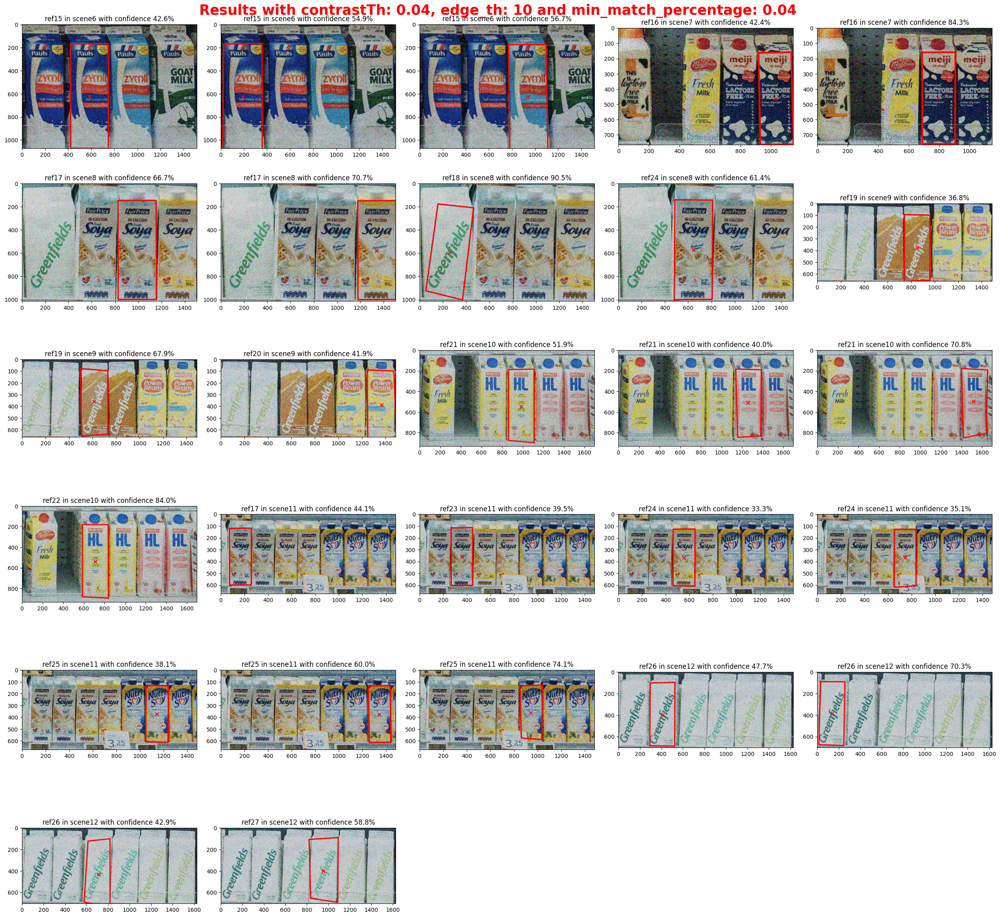

In [ ]:
plot_dict(best_instances6, f'Results with contrastTh: {contrast_th}, edge_th: {edge_th} and min_match_percentage: {mm_perc}', filtered_scenes)

So, at the end, changing the parameters depending on the models, we are able to find more instances. In fact, we find 4 or 5 more instances, but we find also more mismatches.

In particular, in all our attemps, we were never able to find the model 18, which is present in scenes 9 and 12. This is probably due to the small number of points in the model and also, due to the filtering process.

Note also that we can find the models 21 and 22 in the scene 10, but it's difficult to discriminate between them. So, tipically we obtain a serie of mismatches in this scene.

Another scene of interest is the number 8, where we find always one of the models: 18, 26 or 27. But, in theory it is a wrong result because the box is 2 liters instead of one. We think this mismatch is acceptable because it's extremely difficult filter out these matches.

We should find in total 30 true instances, but we are able to find only 19/20 of them, plus a 5 or 6 mismatches.

In [ ]:
# This function has been made only in order to print the obtained results
def print_taskB_solutions(best_instances):
  scenes6 = ['scene6', 'scene7', 'scene8', 'scene9', 'scene10', 'scene11', 'scene12']
  models6 = ['ref15', 'ref16', 'ref17', 'ref18', 'ref19', 'ref20', 'ref21', 'ref22', 'ref23', 'ref24', 'ref25', 'ref26', 'ref27']
  model_in_scenes_counter = {}
  model_in_scenes_counter2 = {}

  for scene in scenes6:
    for model in models6:
      instance_num = 0
      for key, value in best_instances.items():
        if key[0] == model and key[1] == scene:
          instance_num +=1
          model_in_scenes_counter[model, scene, instance_num] = value
          model_in_scenes_counter2[model, scene] = instance_num

  print(model_in_scenes_counter.keys())
  print(model_in_scenes_counter2)

  for scene in scenes6:
    print(f"In {scene} we found: ")
    for model in models6:
      if (model, scene) in model_in_scenes_counter2:
        print(f"\tProduct {model} - {model_in_scenes_counter2[model, scene]} instance found:")

      for key, value in model_in_scenes_counter.items():
        if key[0] == model and key[1] == scene:
          h = np.linalg.norm(np.array(value[3][0][0]) - np.array(value[3][1][0]))
          w = np.linalg.norm(np.array(value[3][1][0]) - np.array(value[3][2][0]))
          print(f"\t\tInstance {key[2]} {{({value[0][0]:.0f},{value[0][1]:.0f}), width: {w:.0f}px, height: {h:.0f}px}}")
    print("\n")

In [ ]:
print_taskB_solutions(best_instances6)

dict_keys([('ref15', 'scene6', 1), ('ref15', 'scene6', 2), ('ref15', 'scene6', 3), ('ref16', 'scene7', 1), ('ref16', 'scene7', 2), ('ref17', 'scene8', 1), ('ref17', 'scene8', 2), ('ref18', 'scene8', 1), ('ref24', 'scene8', 1), ('ref19', 'scene9', 1), ('ref19', 'scene9', 2), ('ref20', 'scene9', 1), ('ref21', 'scene10', 1), ('ref21', 'scene10', 2), ('ref21', 'scene10', 3), ('ref22', 'scene10', 1), ('ref17', 'scene11', 1), ('ref23', 'scene11', 1), ('ref24', 'scene11', 1), ('ref24', 'scene11', 2), ('ref25', 'scene11', 1), ('ref25', 'scene11', 2), ('ref25', 'scene11', 3), ('ref26', 'scene12', 1), ('ref26', 'scene12', 2), ('ref26', 'scene12', 3), ('ref27', 'scene12', 1)])
{('ref15', 'scene6'): 3, ('ref16', 'scene7'): 2, ('ref17', 'scene8'): 2, ('ref18', 'scene8'): 1, ('ref24', 'scene8'): 1, ('ref19', 'scene9'): 2, ('ref20', 'scene9'): 1, ('ref21', 'scene10'): 3, ('ref22', 'scene10'): 1, ('ref17', 'scene11'): 1, ('ref23', 'scene11'): 1, ('ref24', 'scene11'): 2, ('ref25', 'scene11'): 3, ('ref2